In [434]:
import os
from pyuvdata import UVData
import numpy as np
from matplotlib import pyplot as plt
import matplotlib.colors as colors
import matplotlib.gridspec as gridspec

In [253]:
uv = UVData()
uv.read('/lustre/aoc/projects/hera/pstar/autos/2458745_autos_sum.uvh5')

In [141]:
print(uv.antenna_numbers)

[  0   1   2  11  12  13  14  23  24  25  26  39  84  85  86  87  89  91
 101 102 103 104 105 106 108 120 121 122 123 124 125 126]


In [420]:
print(uv.freq_array)
print(uv.freq_array.shape)

[[4.69207764e+07 4.70428467e+07 4.71649170e+07 ... 2.34054565e+08
  2.34176636e+08 2.34298706e+08]]
(1, 1536)


In [166]:
print(uv.lst_array)
print(lst_time)
print(len(uv.lst_array))

[6.11598112 6.11598112 6.11598112 ... 1.16394852 1.16394852 1.16394852]
[0.97338863 0.97338863 0.97338863 ... 0.18524816 0.18524816 0.18524816]
60480


In [421]:
freq= uv.freq_array[0]*1e-6
print(freq)
print(len(freq))
data= np.abs(uv.get_data((1,1, uv.polarization_array[0])))[0]
print(data)
print(len(data))
datafreq_array = np.stack((data,freq))
print(datafreq_array)

[ 46.92077637  47.04284668  47.16491699 ... 234.05456543 234.17663574
 234.29870605]
1536
[4147026. 4243306. 4298776. ... 7816560. 7764941. 7692112.]
1536
[[4.14702600e+06 4.24330600e+06 4.29877600e+06 ... 7.81656000e+06
  7.76494100e+06 7.69211200e+06]
 [4.69207764e+01 4.70428467e+01 4.71649170e+01 ... 2.34054565e+02
  2.34176636e+02 2.34298706e+02]]


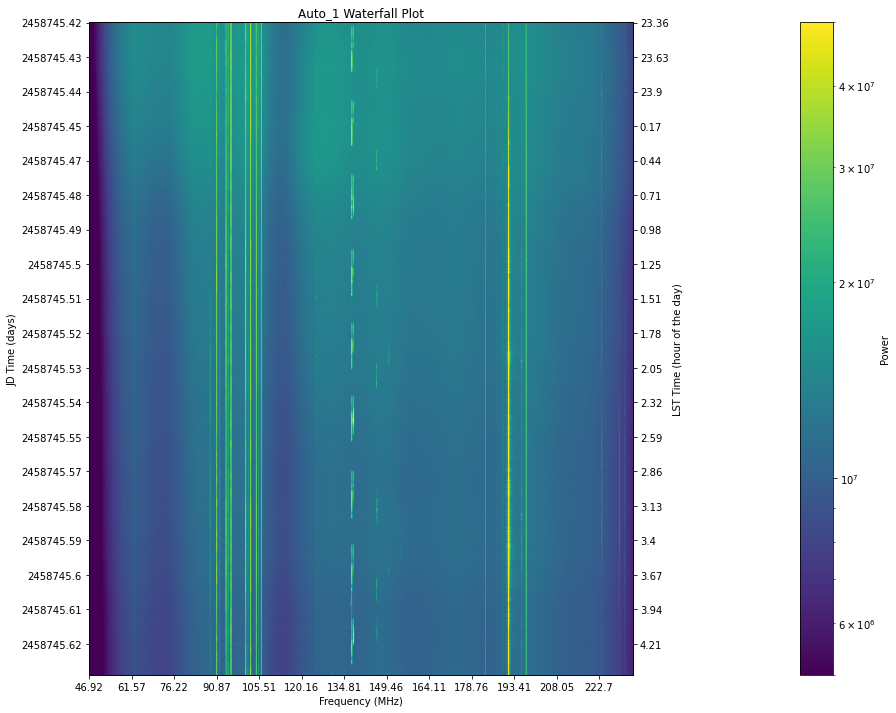

In [476]:
#waterfall plot code

fig = plt.figure(figsize=(15,12))

#create time axis
jd_ax=plt.gca()

#there are a lot of redundancies in time_array, so to make sure that we have a list
#of unique times to work with, we start off by making a new array... not doing this will
#make things get messy. gave me a blank plot at first with a bunch of lines on the side
#before i did this.
times= np.unique(uv.time_array)


#This does the same thing as the previous line of code
#both make an array of size Ntimes
#jds = uv.time_array.reshape(uv.Ntimes,uv.Nbls)
#jds = jds[:,0]


#create the plot. uv.get_data will get data from specified antennas
#colors.LogNorm() puts colors on log scale
im = plt.imshow(np.abs(uv.get_data((1,1, uv.polarization_array[0]))),norm=colors.LogNorm(), 
           vmin=.5*10e6, vmax=.5*10e7, aspect='auto')
plt.title('Auto_1 Waterfall Plot')
plt.xlabel('Frequency (MHz)')

# get an array of frequencies in MHz
freqs = uv.freq_array[0, :] / 1000000
xticks = np.arange(0, len(freqs), 120)
plt.xticks(xticks, labels =np.around(freqs[xticks],2))


jd_ax.set_ylabel('JD Time (days)')

#makes equally spaced ticks in increments of 100. since we are assuming time is pretty
#continuous, this will cover all times pretty well if we go from 0 to the length 
jd_yticks = np.arange(0,len(times),100)
#set_yticks takes a List of y-axis tick locations. its purpose is to set tick locations
jd_ax.set_yticks(jd_yticks)
#this function actually determines what the tickmarks will say.
jd_ax.set_yticklabels(np.around(times[jd_yticks],2))

#pad moves colorbar farther from plot
cbar = plt.colorbar(im, pad= 0.2)
cbar.set_label('Power')


#create second axis
lst_ax = jd_ax.twinx()
lst_ax.set_ylabel('LST Time (hour of the day)')

#lst_array is in radians, and we want it in *hours*.. rad*180/pi = degrees
#one hour= 15 degrees
lst_hours = (uv.lst_array*(180/np.pi))/(15)

#creates array of unique lsts
lsts= lst_hours.reshape(uv.Ntimes,uv.Nbls)
lsts = lsts[:,0]

#set the ticks of the lst axis to match the lst_array in hours
lst_yticks = np.arange(0,len(lsts),100)
lst_ax.set_yticks(lst_yticks)
lst_ax.set_yticklabels(np.around(lsts[lst_yticks],2))

#gives the lst_axis information about the jd_axis. stuff like the y-dimension of the data. 
#gets the axes to line up properly. will make it so that the tick-marks lining up, and the 
#zeroth entry of times[jd_yticks] lining up with the zeroth entry of lsts[lst_yticks]
lst_ax.set_ylim(jd_ax.get_ylim())

#other option for the previous option
#lst_ax.imshow(np.abs(uv.get_data((1,1, uv.polarization_array[0]))),
#              norm=colors.LogNorm(), vmin=.5*10e6, vmax=.5*10e7, aspect='auto') 



#makes it so that the second axis does not alter the structure of the figure
jd_ax.autoscale(False)
lst_ax.autoscale(False)

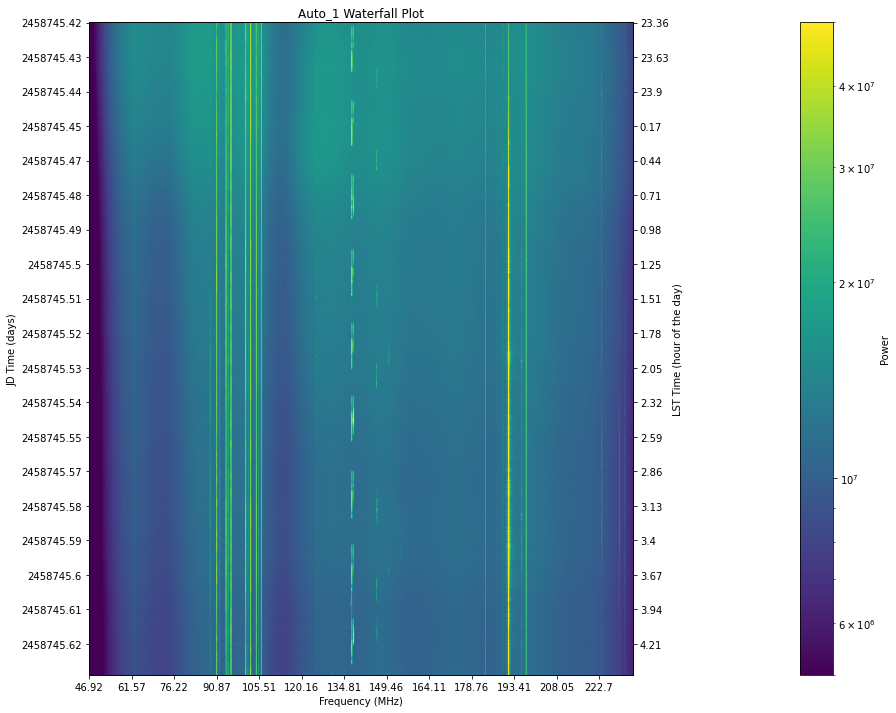

In [477]:
#shortened version of cell above


fig = plt.figure(figsize=(15,12))

#create time axis
jd_ax=plt.gca()

#there are a lot of redundancies in time_array, so to make sure that we have a list
#of unique times to work with, we start off by making a new array... not doing this will
#make things get messy. gave me a blank plot at first with a bunch of lines on the side
#before i did this.
times= np.unique(uv.time_array)

#create the plot. uv.get_data will get data from specified antennas
#colors.LogNorm() puts colors on log scale
im = plt.imshow(np.abs(uv.get_data((1,1, uv.polarization_array[0]))),norm=colors.LogNorm(), 
           vmin=.5*10e6, vmax=.5*10e7, aspect='auto')
plt.title('Auto_1 Waterfall Plot')
plt.xlabel('Frequency (MHz)')

# get an array of frequencies in MHz
freqs = uv.freq_array[0, :] / 1000000
xticks = np.arange(0, len(freqs), 120)
plt.xticks(xticks, labels =np.around(freqs[xticks],2))


jd_ax.set_ylabel('JD Time (days)')

#makes equally spaced ticks in increments of 100. since we are assuming time is pretty
#continuous, this will cover all times pretty well if we go from 0 to the length 
jd_yticks = np.arange(0,len(times),100)
#set_yticks takes a List of y-axis tick locations. its purpose is to set tick locations
jd_ax.set_yticks(jd_yticks)
#this function actually determines what the tickmarks will say.
jd_ax.set_yticklabels(np.around(times[jd_yticks],2))

#pad moves colorbar farther from plot
cbar = plt.colorbar(im, pad= 0.2)
cbar.set_label('Power')


#create second axis
lst_ax = jd_ax.twinx()
lst_ax.set_ylabel('LST Time (hour of the day)')

#lst_array is in radians, and we want it in *hours*.. rad*180/pi = degrees
#one hour= 15 degrees
lst_hours = (uv.lst_array*(180/np.pi))/(15)

#creates array of unique lsts
lsts= lst_hours.reshape(uv.Ntimes,uv.Nbls)
lsts = lsts[:,0]

#set the ticks of the lst axis to match the lst_array in hours
lst_yticks = np.arange(0,len(lsts),100)
lst_ax.set_yticks(lst_yticks)
lst_ax.set_yticklabels(np.around(lsts[lst_yticks],2))

#gives the lst_axis information about the jd_axis. stuff like the y-dimension of the data. 
#gets the axes to line up properly. will make it so that the tick-marks lining up, and the 
#zeroth entry of times[jd_yticks] lining up with the zeroth entry of lsts[lst_yticks]
lst_ax.set_ylim(jd_ax.get_ylim())

#makes it so that the second axis does not alter the structure of the figure
jd_ax.autoscale(False)
lst_ax.autoscale(False)

In [478]:
def singleauto_waterfall (ant, colorbar_min, colorbar_max):
    
    fig = plt.figure(figsize=(15,12))
    
    

    #create time axis
    jd_ax=plt.gca()

    #there are a lot of redundancies in time_array, so to make sure that we have a list
    #of unique times to work with, we start off by making a new array... not doing this will
    #make things get messy. gave me a blank plot at first with a bunch of lines on the side
    #before i did this.
    times= np.unique(uv.time_array)

    #create the plot. uv.get_data will get data from specified antennas
    #colors.LogNorm() puts colors on log scale
    im = plt.imshow(np.abs(uv.get_data((ant,ant, uv.polarization_array[0]))),norm=colors.LogNorm(), 
           vmin=colorbar_min, vmax=colorbar_max, aspect='auto')
    plt.title('Auto_'+str(ant)+' Waterfall Plot')
    plt.xlabel('Frequency (MHz)')
    
    # get an array of frequencies in MHz
    freqs = uv.freq_array[0, :] / 1000000
    xticks = np.arange(0, len(freqs), 120)
    plt.xticks(xticks, labels =np.around(freqs[xticks],2))


    jd_ax.set_ylabel('JD Time (days)')

    #makes equally spaced ticks in increments of 100. since we are assuming time is pretty
    #continuous, this will cover all times pretty well if we go from 0 to the length 
    jd_yticks = np.arange(0,len(times),100)
    #set_yticks takes a List of y-axis tick locations. its purpose is to set tick locations
    jd_ax.set_yticks(jd_yticks)
    #this function actually determines what the tickmarks will say.
    jd_ax.set_yticklabels(np.around(times[jd_yticks],2))

    #pad moves colorbar farther from plot
    cbar = plt.colorbar(im, pad= 0.2)
    cbar.set_label('Power')


    #create second axis
    lst_ax = jd_ax.twinx()
    lst_ax.set_ylabel('LST Time (hour of the day)')

    #lst_array is in radians, and we want it in *hours*.. rad*180/pi = degrees
    #one hour= 15 degrees
    lst_hours = (uv.lst_array*(180/np.pi))/(15)

    #creates array of unique lsts
    lsts= lst_hours.reshape(uv.Ntimes,uv.Nbls)
    lsts = lsts[:,0]

    #set the ticks of the lst axis to match the lst_array in hours
    lst_yticks = np.arange(0,len(lsts),100)
    lst_ax.set_yticks(lst_yticks)
    lst_ax.set_yticklabels(np.around(lsts[lst_yticks],2))

    #gives the lst_axis information about the jd_axis. stuff like the y-dimension of the data. 
    #gets the axes to line up properly. will make it so that the tick-marks lining up, and the 
    #zeroth entry of times[jd_yticks] lining up with the zeroth entry of lsts[lst_yticks]
    lst_ax.set_ylim(jd_ax.get_ylim())

    #makes it so that the second axis does not alter the structure of the figure
    jd_ax.autoscale(False)
    lst_ax.autoscale(False)
    
    plt.show()
    plt.close()
    return;

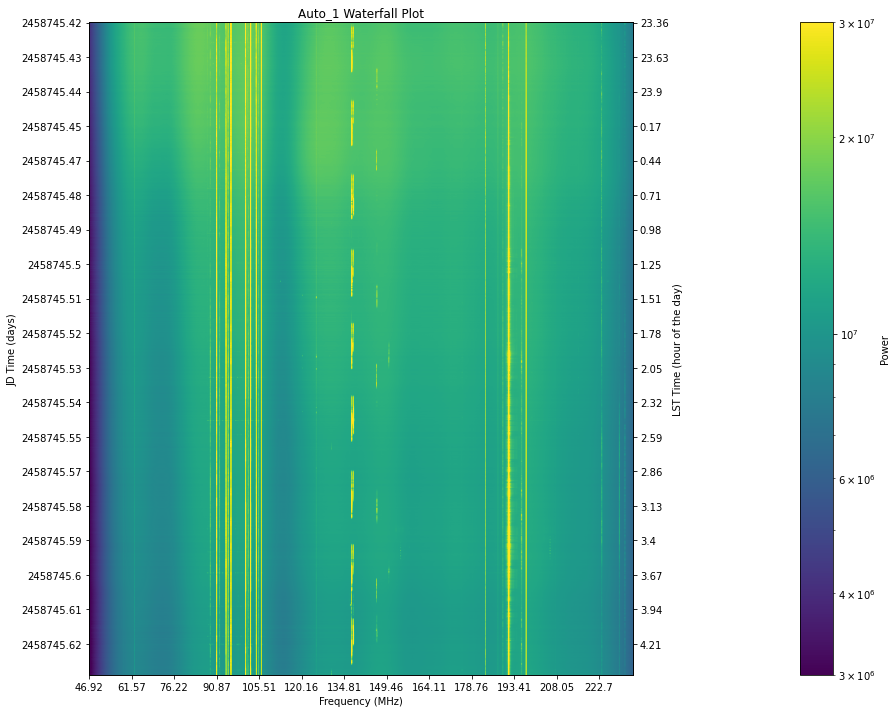

In [479]:
singleauto_waterfall(1, 0.3*10e6, 0.3*10e7)

In [480]:
def allauto_waterfall (colorbar_min, colorbar_max):
    
    for ant in uv.antenna_numbers:
    
        fig = plt.figure(figsize=(15,12))
    
    

        #create time axis
        jd_ax=plt.gca()

        #there are a lot of redundancies in time_array, so to make sure that we have a list
        #of unique times to work with, we start off by making a new array... not doing this will
        #make things get messy. gave me a blank plot at first with a bunch of lines on the side
        #before i did this.
        times= np.unique(uv.time_array)

        #create the plot. uv.get_data will get data from specified antennas
        #colors.LogNorm() puts colors on log scale
        im = plt.imshow(np.abs(uv.get_data((ant,ant, uv.polarization_array[0]))),norm=colors.LogNorm(), 
           vmin=colorbar_min, vmax=colorbar_max, aspect='auto')
        plt.title('Auto_'+str(ant)+' Waterfall Plot')
        plt.xlabel('Frequency (MHz)')
        
        # get an array of frequencies in MHz
        freqs = uv.freq_array[0, :] / 1000000
        xticks = np.arange(0, len(freqs), 120)
        plt.xticks(xticks, labels =np.around(freqs[xticks],2))


        jd_ax.set_ylabel('JD Time (days)')

        #makes equally spaced ticks in increments of 100. since we are assuming time is pretty
         #continuous, this will cover all times pretty well if we go from 0 to the length 
        jd_yticks = np.arange(0,len(times),100)
        #set_yticks takes a List of y-axis tick locations. its purpose is to set tick locations
        jd_ax.set_yticks(jd_yticks)
        #this function actually determines what the tickmarks will say.
        jd_ax.set_yticklabels(np.around(times[jd_yticks],2))

        #pad moves colorbar farther from plot
        cbar = plt.colorbar(im, pad= 0.2)
        cbar.set_label('Power')


        #create second axis
        lst_ax = jd_ax.twinx()
        lst_ax.set_ylabel('LST Time (hour of the day)')

        #lst_array is in radians, and we want it in *hours*.. rad*180/pi = degrees
        #one hour= 15 degrees
        lst_hours = (uv.lst_array*(180/np.pi))/(15)

        #creates array of unique lsts
        lsts= lst_hours.reshape(uv.Ntimes,uv.Nbls)
        lsts = lsts[:,0]

        #set the ticks of the lst axis to match the lst_array in hours
        lst_yticks = np.arange(0,len(lsts),100)
        lst_ax.set_yticks(lst_yticks)
        lst_ax.set_yticklabels(np.around(lsts[lst_yticks],2))

        #gives the lst_axis information about the jd_axis. stuff like the y-dimension of the data. 
        #gets the axes to line up properly. will make it so that the tick-marks lining up, and the 
        #zeroth entry of times[jd_yticks] lining up with the zeroth entry of lsts[lst_yticks]
        lst_ax.set_ylim(jd_ax.get_ylim())

        #makes it so that the second axis does not alter the structure of the figure
        jd_ax.autoscale(False)
        lst_ax.autoscale(False)
        
        plt.savefig('/lustre/aoc/projects/hera/amyers/gitrepos/monsterDetection/waterfalls/'+
                    'WF_ant'+str(ant))
        plt.show()
        plt.close()
    return;

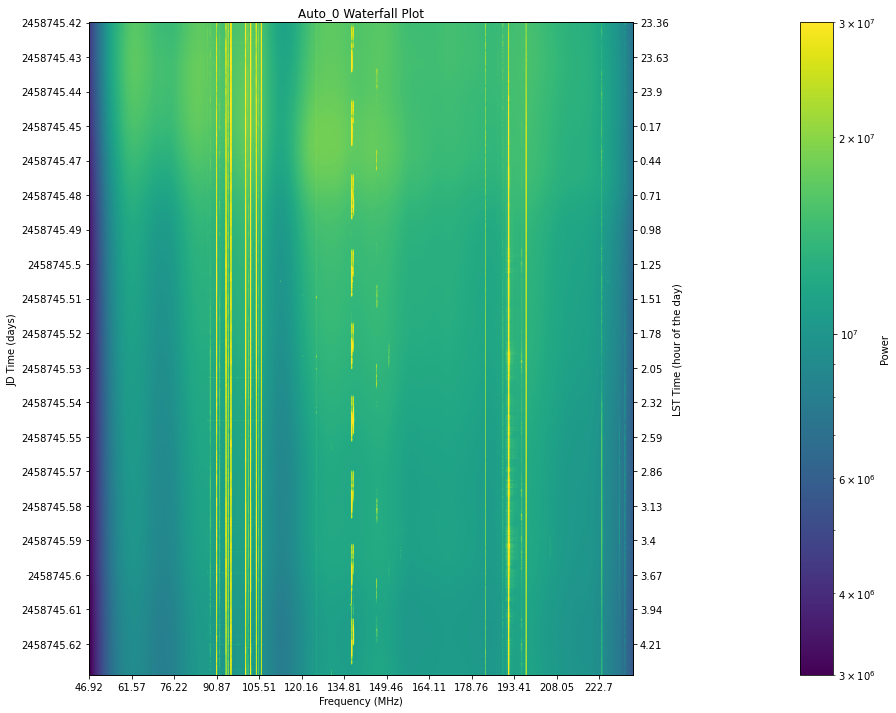

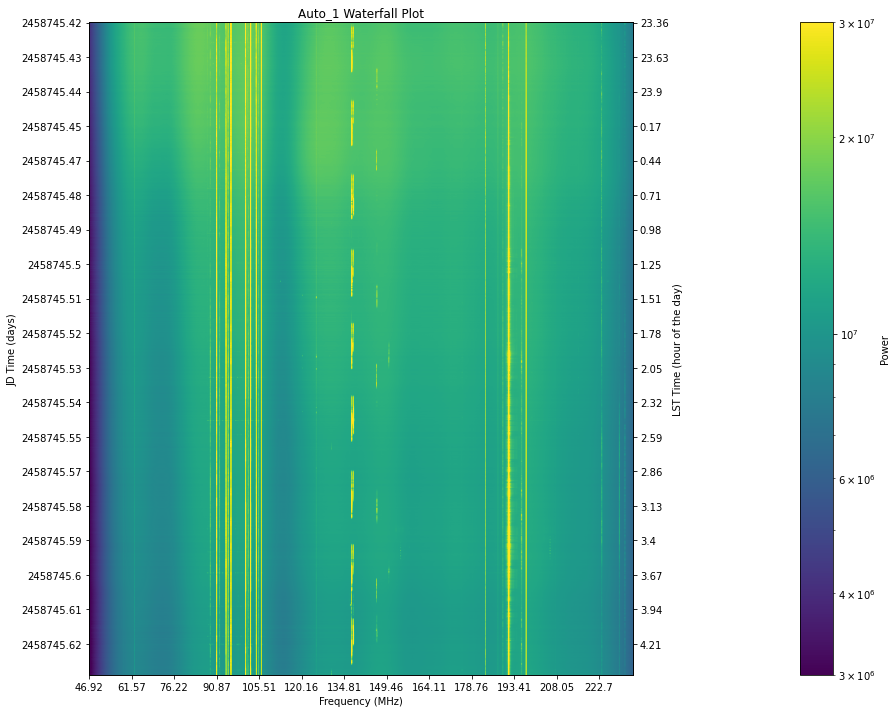

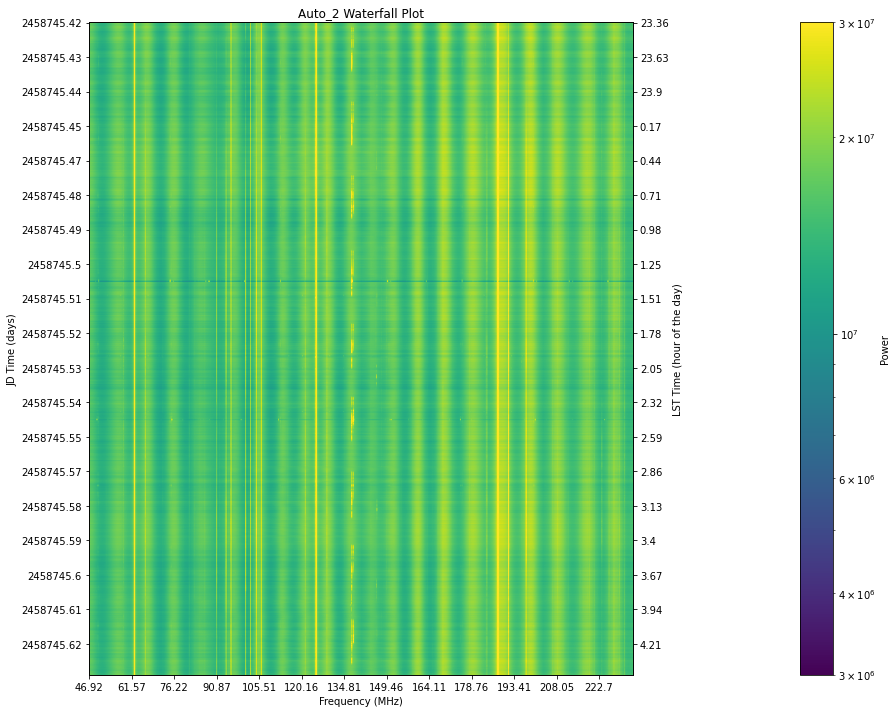

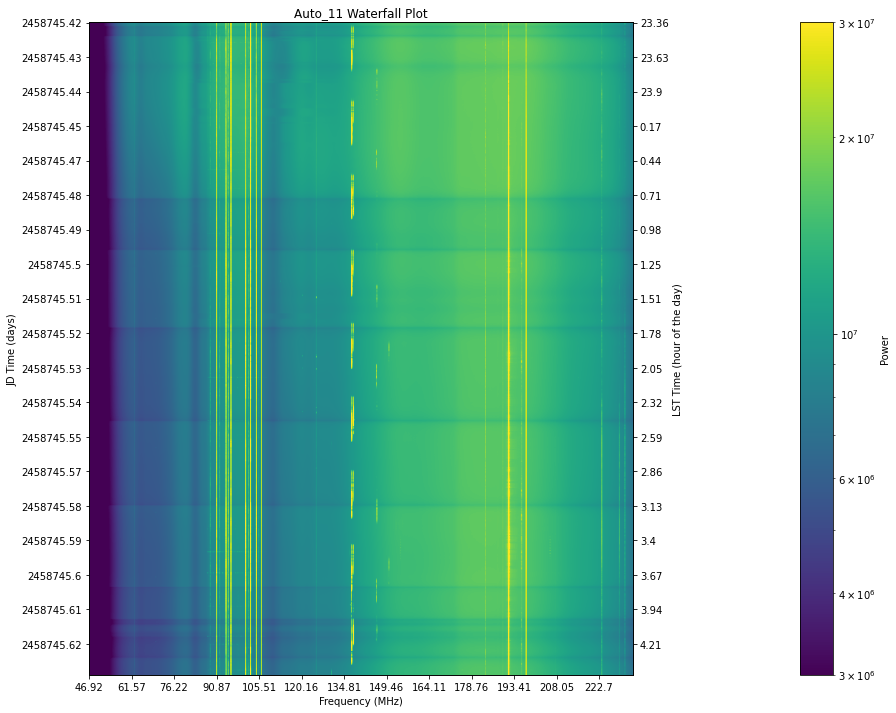

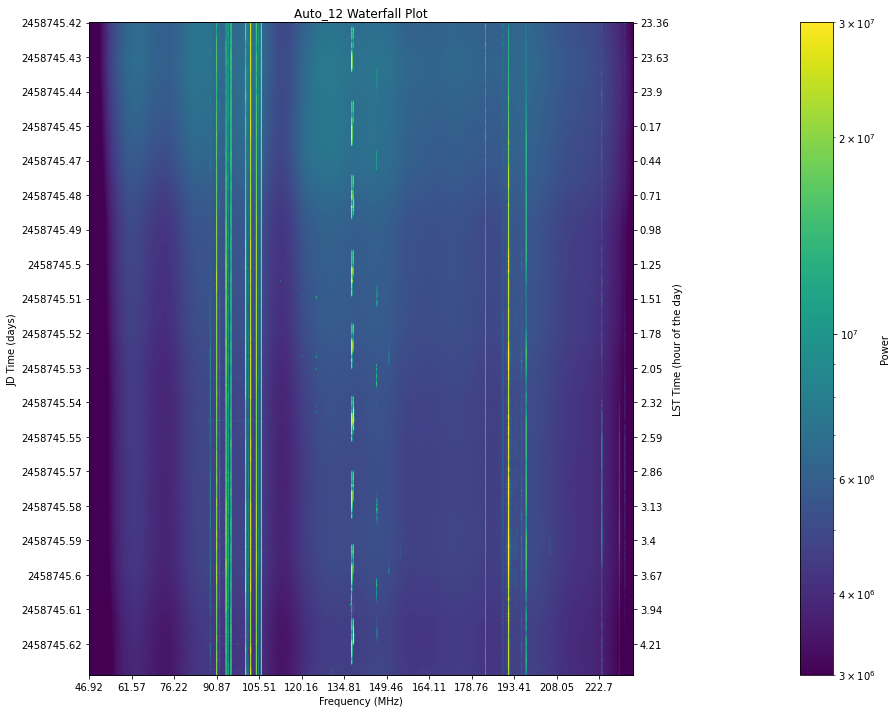

...

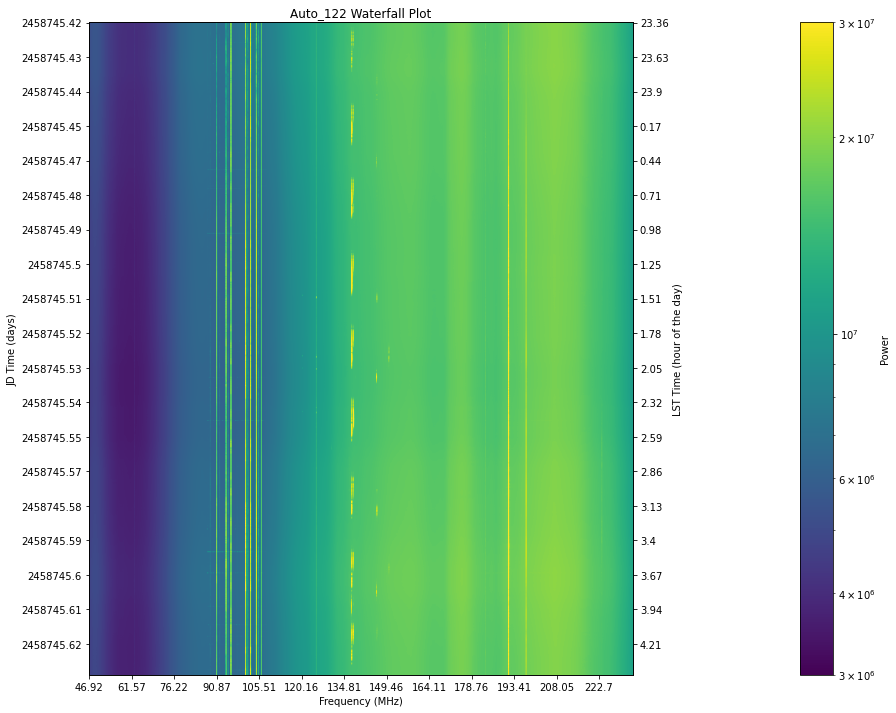

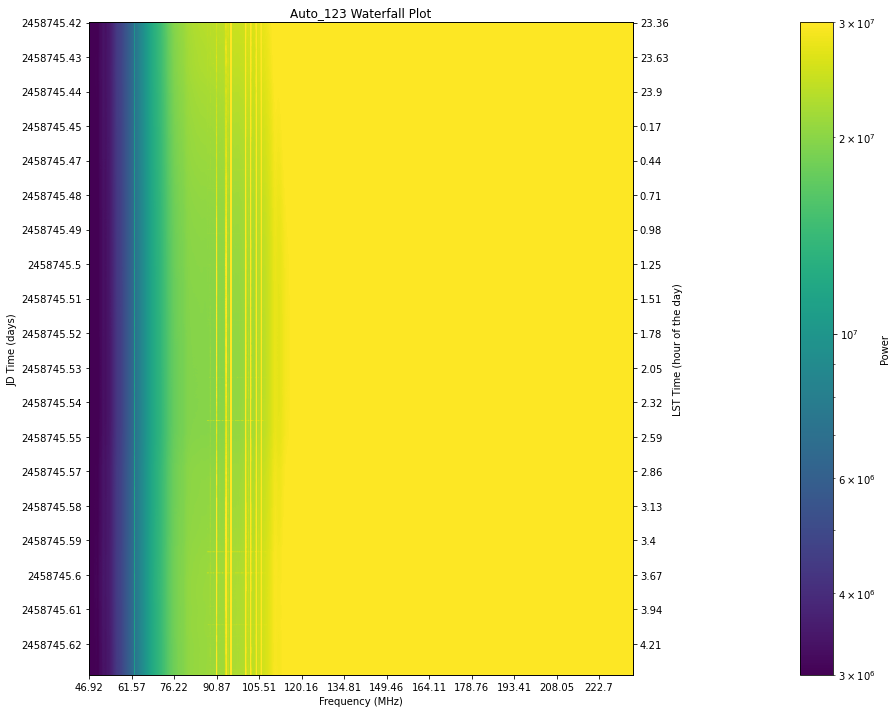

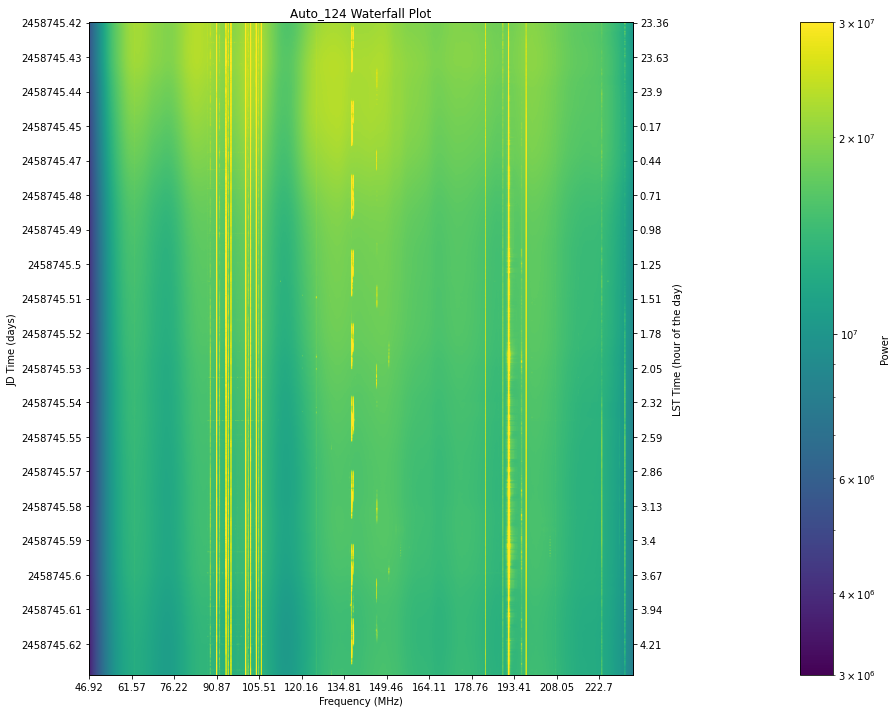

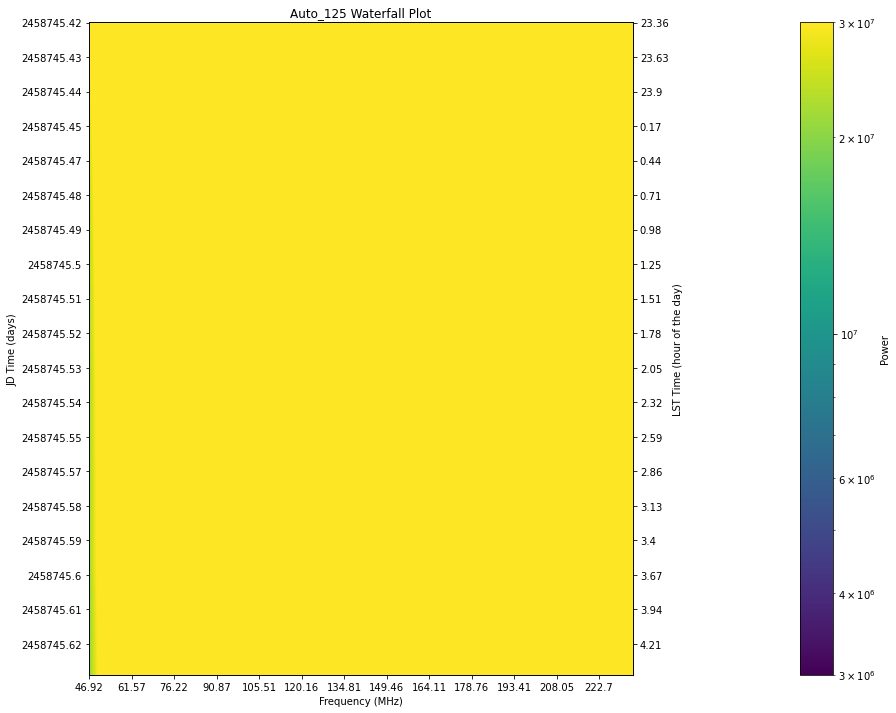

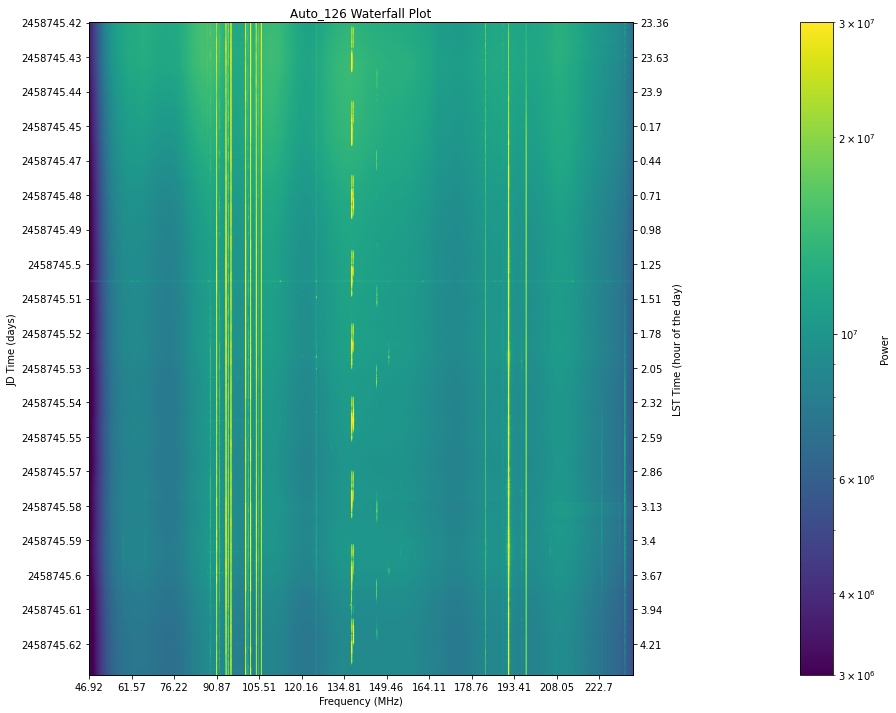

In [481]:
allauto_waterfall(0.3*10e6, 0.3*10e7)

In [398]:
freq = uv.freq_array[0]*1e-6
times = np.unique(uv.time_array)
antnums = sorted(uv.antenna_numbers)

def all_lineplots():
    
    fig = plt.figure(figsize=(16,30))
    nants = len(uv.antenna_numbers)
    Y=5
    X= nants//Y+1
    for i, ant in enumerate(antnums):
        
        plt.subplot(X,Y,i+1)
        dat = np.abs(uv.get_data((ant,ant,'xx'))[0])
        plt.plot(freq,dat)
        plt.title(ant)
        plt.yscale('log')
    plt.suptitle('Per-antenna Autospectra', y=0.98)
    fig.tight_layout()
    plt.subplots_adjust(top=0.95)
    return;

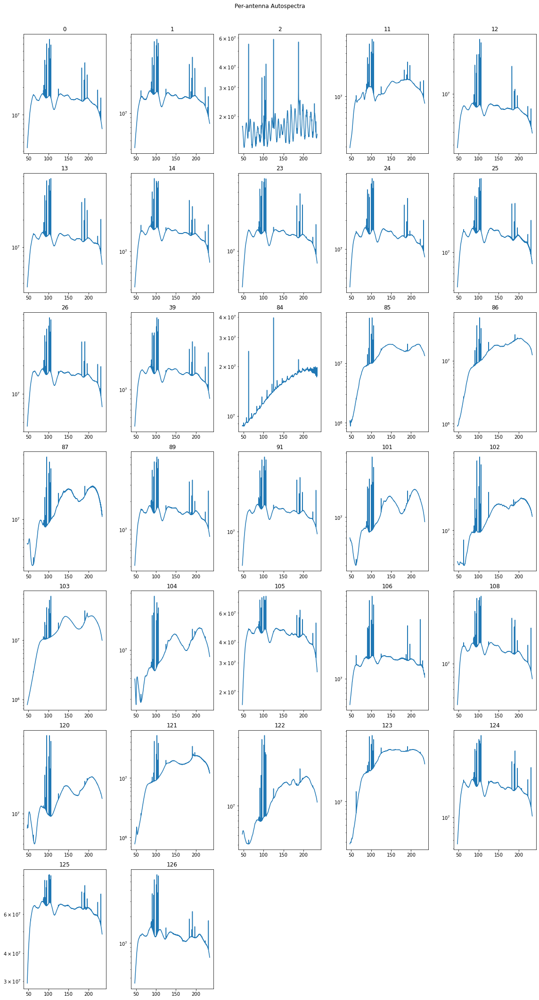

In [399]:
all_lineplots()

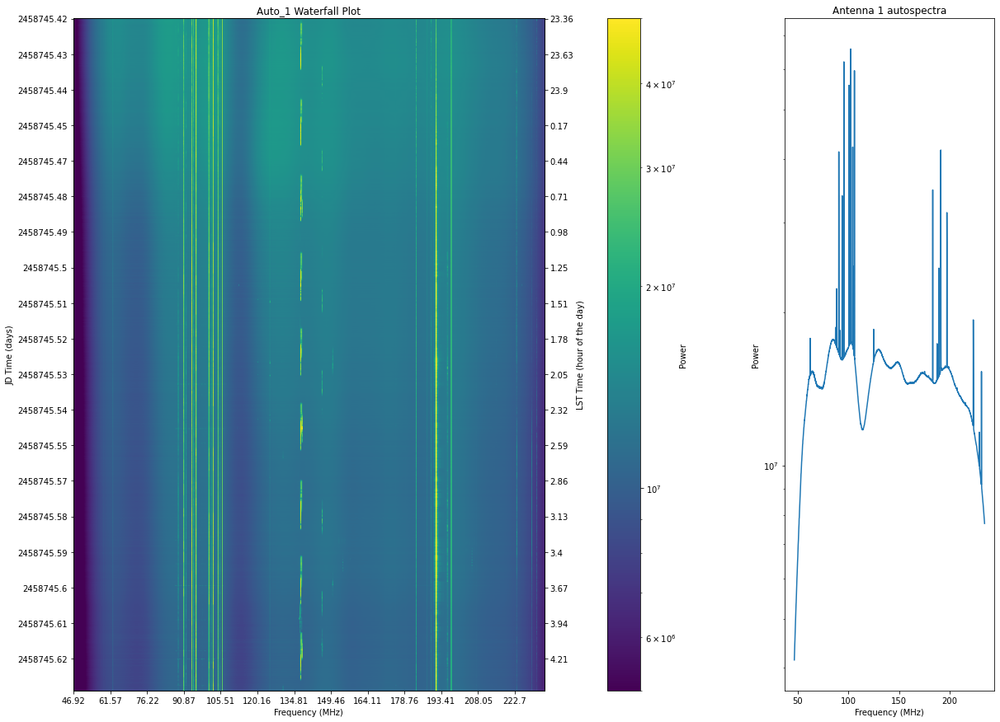

In [482]:
#code for one side by side waterfall + plot

freq = uv.freq_array[0]*1e-6
fig = plt.figure(figsize=(20,15))
axes=[]

#can use gridspec instead of saying add_subplot(1,2,1) etc
gs = gridspec.GridSpec(1, 2, width_ratios=[3, 1]) 

axes.append(fig.add_subplot(gs[0]))

#create time axis
jd_ax=plt.gca()

#there are a lot of redundancies in time_array, so to make sure that we have a list
#of unique times to work with, we start off by making a new array... not doing this will
#make things get messy. gave me a blank plot at first with a bunch of lines on the side
#before i did this.
times= np.unique(uv.time_array)

#create the plot. uv.get_data will get data from specified antennas
#colors.LogNorm() puts colors on log scale
im = plt.imshow(np.abs(uv.get_data((1,1, uv.polarization_array[0]))),norm=colors.LogNorm(), 
           vmin=.5*10e6, vmax=.5*10e7, aspect='auto')
axes[0].set_title('Auto_1 Waterfall Plot')
axes[0].set_xlabel('Frequency (MHz)')

# get an array of frequencies in MHz
freqs = uv.freq_array[0, :] / 1000000
xticks = np.arange(0, len(freqs), 120)
plt.xticks(xticks, labels =np.around(freqs[xticks],2))


jd_ax.set_ylabel('JD Time (days)')

#makes equally spaced ticks in increments of 100. since we are assuming time is pretty
#continuous, this will cover all times pretty well if we go from 0 to the length 
jd_yticks = np.arange(0,len(times),100)
#set_yticks takes a List of y-axis tick locations. its purpose is to set tick locations
jd_ax.set_yticks(jd_yticks)
#this function actually determines what the tickmarks will say.
jd_ax.set_yticklabels(np.around(times[jd_yticks],2))

#pad moves colorbar farther from plot
cbar = plt.colorbar(im, pad= 0.1)
cbar.set_label('Power')


#create second axis
lst_ax = jd_ax.twinx()
lst_ax.set_ylabel('LST Time (hour of the day)')

#lst_array is in radians, and we want it in *hours*.. rad*180/pi = degrees
#one hour= 15 degrees
lst_hours = (uv.lst_array*(180/np.pi))/(15)

#creates array of unique lsts
lsts= lst_hours.reshape(uv.Ntimes,uv.Nbls)
lsts = lsts[:,0]

#set the ticks of the lst axis to match the lst_array in hours
lst_yticks = np.arange(0,len(lsts),100)
lst_ax.set_yticks(lst_yticks)
lst_ax.set_yticklabels(np.around(lsts[lst_yticks],2))

#gives the lst_axis information about the jd_axis. stuff like the y-dimension of the data. 
#gets the axes to line up properly. will make it so that the tick-marks lining up, and the 
#zeroth entry of times[jd_yticks] lining up with the zeroth entry of lsts[lst_yticks]
lst_ax.set_ylim(jd_ax.get_ylim())

#makes it so that the second axis does not alter the structure of the figure
jd_ax.autoscale(False)
lst_ax.autoscale(False)

axes.append(fig.add_subplot(gs[1]))

plt.plot(freq,np.abs(uv.get_data((1,1, uv.polarization_array[0]))[0]))
axes[1].set_yscale('log')
axes[1].set_xlabel('Frequency (MHz)')
axes[1].set_ylabel('Power')
axes[1].set_title('Antenna 1 autospectra')

plt.savefig('/lustre/aoc/projects/hera/amyers/gitrepos/monsterDetection/waterfalls/'+
                    'WF_LP_ant'+str(1))
plt.show()
plt.close()

In [588]:
averaged_data= np.abs(np.average(uv.get_data((1,1, uv.polarization_array[0])),0))
print(averaged_data)

[3160539.17354497 3214412.55502646 3274922.11798942 ... 6964137.18465609
 6909084.35978836 6857962.42592593]


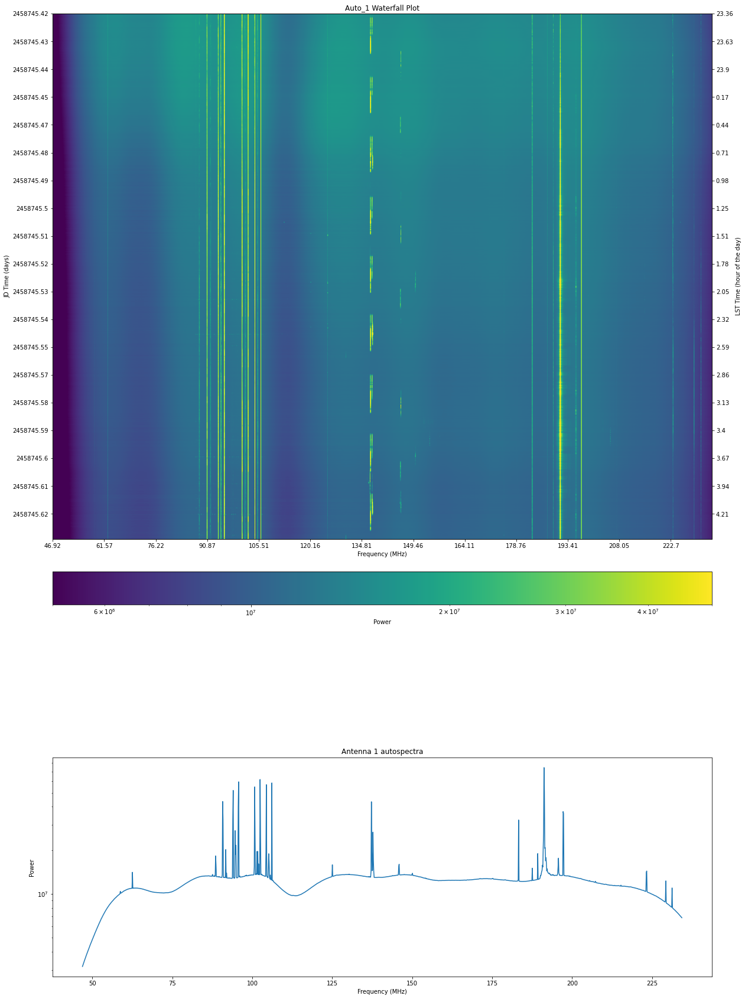

In [589]:
#code for one waterfall + plot stacked vertically

freq = uv.freq_array[0]*1e-6
fig = plt.figure(figsize=(20,30))
axes=[]

#can use gridspec instead of saying add_subplot(1,2,1) etc
gs = gridspec.GridSpec(2, 1, height_ratios=[3,1]) 

axes.append(fig.add_subplot(gs[0]))

#create time axis
jd_ax=plt.gca()

#there are a lot of redundancies in time_array, so to make sure that we have a list
#of unique times to work with, we start off by making a new array... not doing this will
#make things get messy. gave me a blank plot at first with a bunch of lines on the side
#before i did this.
times= np.unique(uv.time_array)

#create the plot. uv.get_data will get data from specified antennas
#colors.LogNorm() puts colors on log scale
im = plt.imshow(np.abs(uv.get_data((1,1, uv.polarization_array[0]))),norm=colors.LogNorm(), 
           vmin=.5*10e6, vmax=.5*10e7, aspect='auto')
axes[0].set_title('Auto_1 Waterfall Plot')
axes[0].set_xlabel('Frequency (MHz)')

# get an array of frequencies in MHz
freqs = uv.freq_array[0, :] / 1000000
xticks = np.arange(0, len(freqs), 120)
plt.xticks(xticks, labels =np.around(freqs[xticks],2))


jd_ax.set_ylabel('JD Time (days)')

#makes equally spaced ticks in increments of 100. since we are assuming time is pretty
#continuous, this will cover all times pretty well if we go from 0 to the length 
jd_yticks = np.arange(0,len(times),100)
#set_yticks takes a List of y-axis tick locations. its purpose is to set tick locations
jd_ax.set_yticks(jd_yticks)
#this function actually determines what the tickmarks will say.
jd_ax.set_yticklabels(np.around(times[jd_yticks],2))

#pad moves colorbar farther from plot
cbar = plt.colorbar(im, pad= 0.05, orientation='horizontal')
cbar.set_label('Power')


#create second axis
lst_ax = jd_ax.twinx()
lst_ax.set_ylabel('LST Time (hour of the day)')

#lst_array is in radians, and we want it in *hours*.. rad*180/pi = degrees
#one hour= 15 degrees
lst_hours = (uv.lst_array*(180/np.pi))/(15)

#creates array of unique lsts
lsts= lst_hours.reshape(uv.Ntimes,uv.Nbls)
lsts = lsts[:,0]

#set the ticks of the lst axis to match the lst_array in hours
lst_yticks = np.arange(0,len(lsts),100)
lst_ax.set_yticks(lst_yticks)
lst_ax.set_yticklabels(np.around(lsts[lst_yticks],2))

#gives the lst_axis information about the jd_axis. stuff like the y-dimension of the data. 
#gets the axes to line up properly. will make it so that the tick-marks lining up, and the 
#zeroth entry of times[jd_yticks] lining up with the zeroth entry of lsts[lst_yticks]
lst_ax.set_ylim(jd_ax.get_ylim())

#makes it so that the second axis does not alter the structure of the figure
jd_ax.autoscale(False)
lst_ax.autoscale(False)

axes.append(fig.add_subplot(gs[1]))

averaged_data= np.abs(np.average(uv.get_data((1,1, uv.polarization_array[0])),0))

plt.plot(freq,averaged_data)
axes[1].set_yscale('log')
axes[1].set_xlabel('Frequency (MHz)')
axes[1].set_ylabel('Power')
axes[1].set_title('Antenna 1 autospectra')

plt.savefig('/lustre/aoc/projects/hera/amyers/gitrepos/monsterDetection/waterfalls/'+
                    'WF_LP_ant'+str(1))
plt.show()
plt.close()

In [590]:
def separate_allauto_waterfall_lineplot (colorbar_min, colorbar_max):
    
    for ant in uv.antenna_numbers:
        freq = uv.freq_array[0]*1e-6
        fig = plt.figure(figsize=(20,15))
        axes=[]

        #can use gridspec instead of saying add_subplot(1,2,1) etc
        gs = gridspec.GridSpec(2, 1, height_ratios=[3,1])

        axes.append(fig.add_subplot(gs[0]))

        #create time axis
        jd_ax=plt.gca()

        #there are a lot of redundancies in time_array, so to make sure that we have a list
        #of unique times to work with, we start off by making a new array... not doing this will
        #make things get messy. gave me a blank plot at first with a bunch of lines on the side
        #before i did this.
        times= np.unique(uv.time_array)

        #create the plot. uv.get_data will get data from specified antennas
        #colors.LogNorm() puts colors on log scale
        im = plt.imshow(np.abs(uv.get_data((ant,ant, uv.polarization_array[0]))),norm=colors.LogNorm(), 
                   vmin=.5*10e6, vmax=.5*10e7, aspect='auto')
        axes[0].set_title('Auto_'+str(ant)+' Waterfall Plot')
        axes[0].set_xlabel('Frequency (MHz)')
        
        # get an array of frequencies in MHz
        freqs = uv.freq_array[0, :] / 1000000
        xticks = np.arange(0, len(freqs), 120)
        plt.xticks(xticks, labels =np.around(freqs[xticks],2))


        jd_ax.set_ylabel('JD Time (days)')

        #makes equally spaced ticks in increments of 100. since we are assuming time is pretty
        #continuous, this will cover all times pretty well if we go from 0 to the length 
        jd_yticks = np.arange(0,len(times),100)
        #set_yticks takes a List of y-axis tick locations. its purpose is to set tick locations
        jd_ax.set_yticks(jd_yticks)
        #this function actually determines what the tickmarks will say.
        jd_ax.set_yticklabels(np.around(times[jd_yticks],2))

        #pad moves colorbar farther from plot
        cbar = plt.colorbar(im, pad= 0.05, orientation='horizontal')
        cbar.set_label('Power')


        #create second axis
        lst_ax = jd_ax.twinx()
        lst_ax.set_ylabel('LST Time (hour of the day)')

        #lst_array is in radians, and we want it in *hours*.. rad*180/pi = degrees
        #one hour= 15 degrees
        lst_hours = (uv.lst_array*(180/np.pi))/(15)
        
        #creates array of unique lsts
        lsts= lst_hours.reshape(uv.Ntimes,uv.Nbls)
        lsts = lsts[:,0]

        #set the ticks of the lst axis to match the lst_array in hours
        lst_yticks = np.arange(0,len(lsts),100)
        lst_ax.set_yticks(lst_yticks)
        lst_ax.set_yticklabels(np.around(lsts[lst_yticks],2))

        #gives the lst_axis information about the jd_axis. stuff like the y-dimension of the data. 
        #gets the axes to line up properly. will make it so that the tick-marks lining up, and the 
        #zeroth entry of times[jd_yticks] lining up with the zeroth entry of lsts[lst_yticks]
        lst_ax.set_ylim(jd_ax.get_ylim())

        #makes it so that the second axis does not alter the structure of the figure
        jd_ax.autoscale(False)
        lst_ax.autoscale(False)

        axes.append(fig.add_subplot(gs[1]))

        averaged_data= np.abs(np.average(uv.get_data((1,1, uv.polarization_array[0])),0))

        plt.plot(freq,averaged_data)
        axes[1].set_yscale('log')
        axes[1].set_xlabel('Frequency (MHz)')
        axes[1].set_ylabel('Power')
        axes[1].set_title('Antenna_'+str(ant)+' autospectra')

        plt.savefig('/lustre/aoc/projects/hera/amyers/gitrepos/monsterDetection/waterfalls/'+
                    'sep_WF_LP_ant'+str(1))
        plt.show()
        plt.close()
    return;

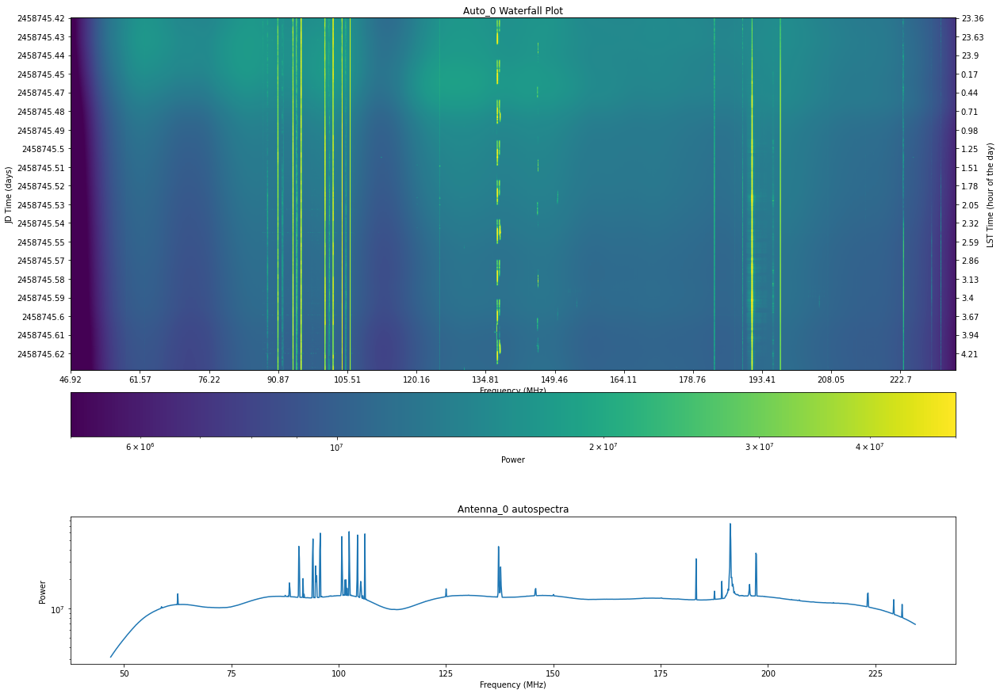

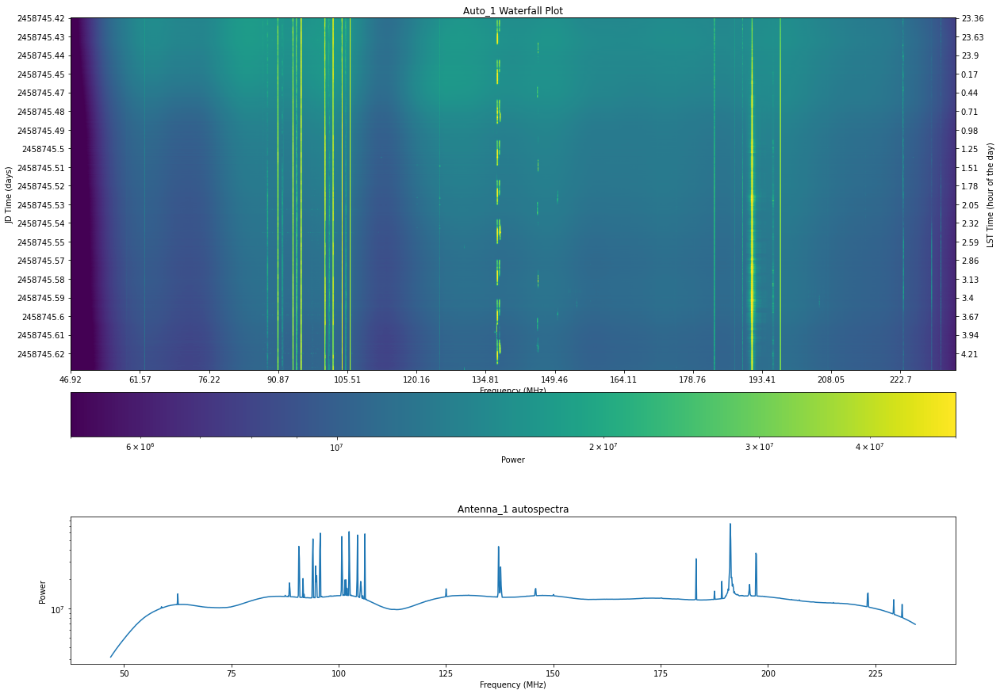

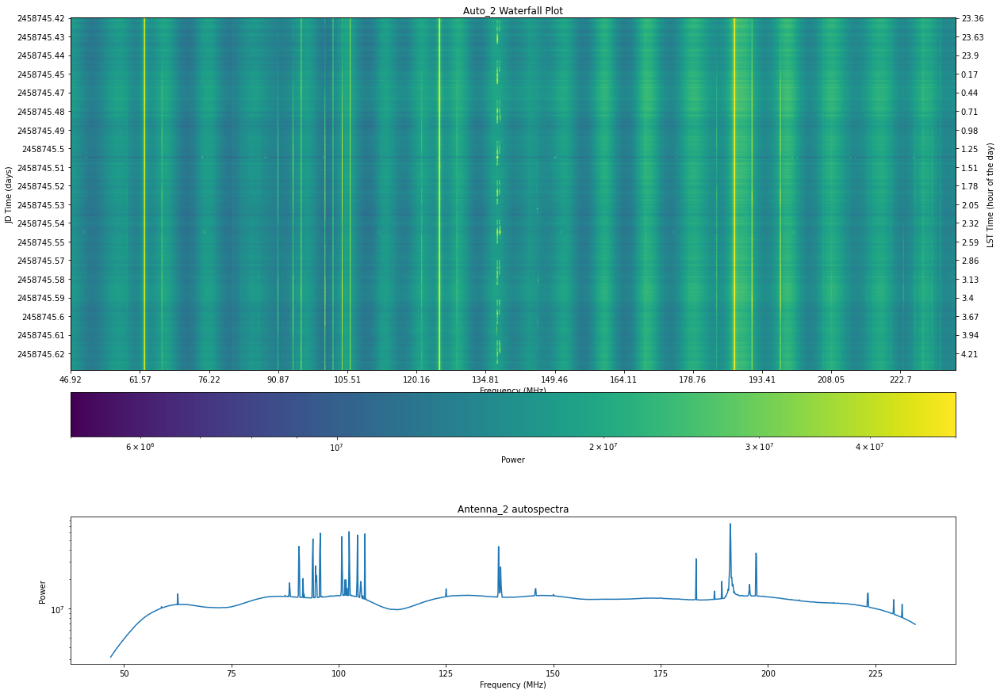

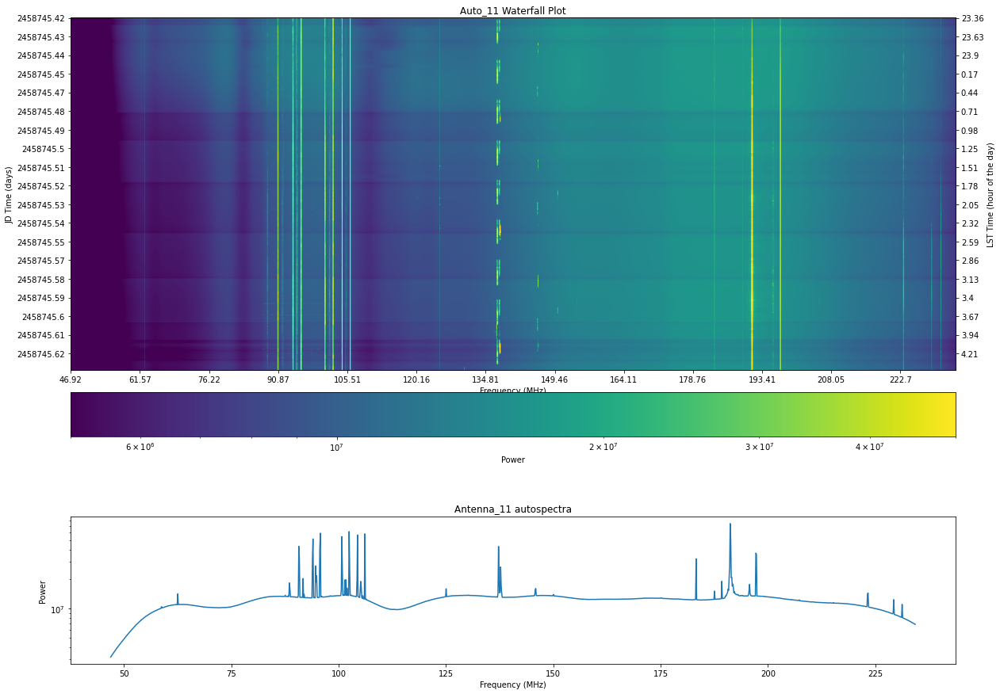

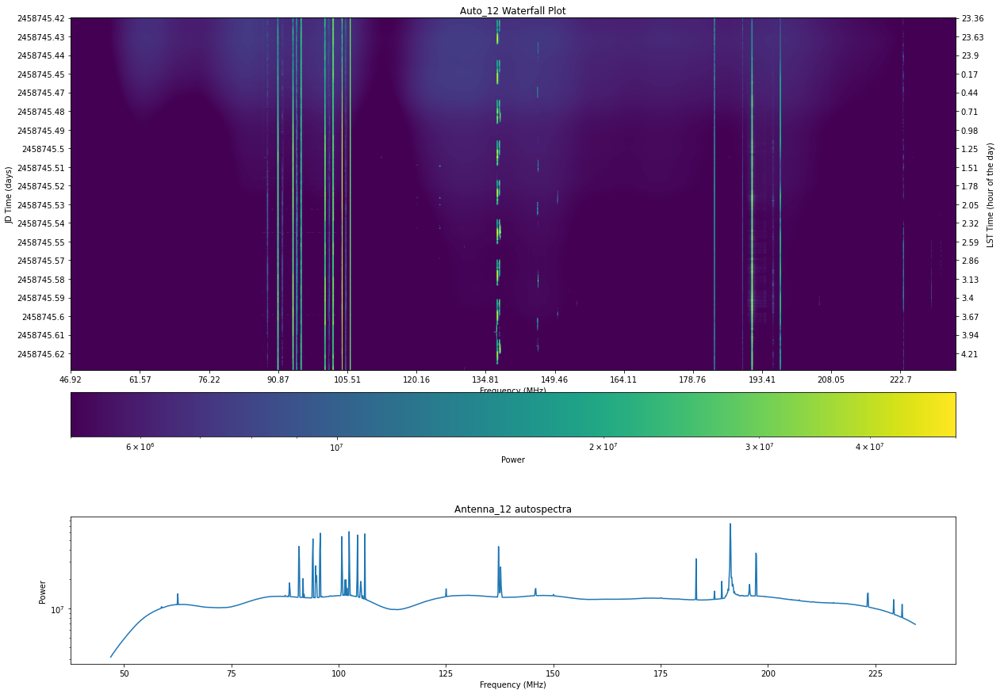

...

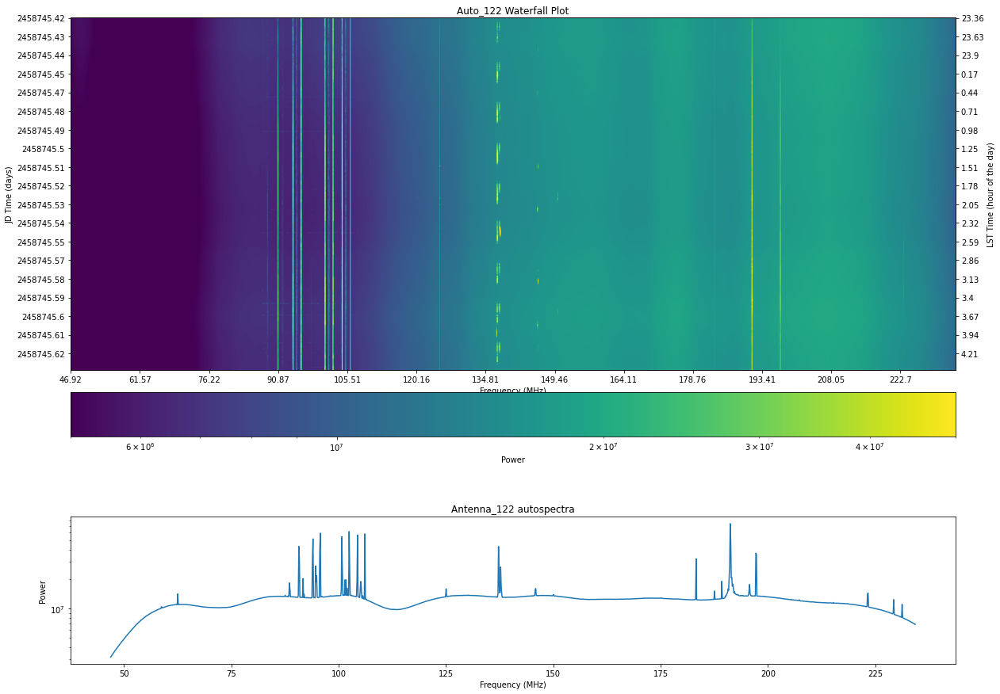

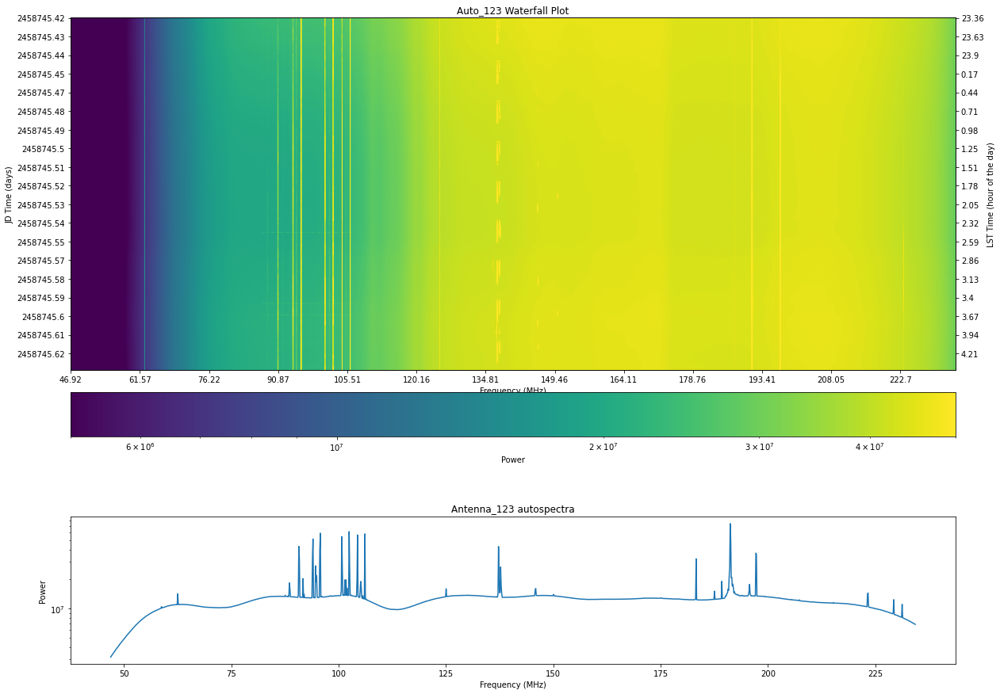

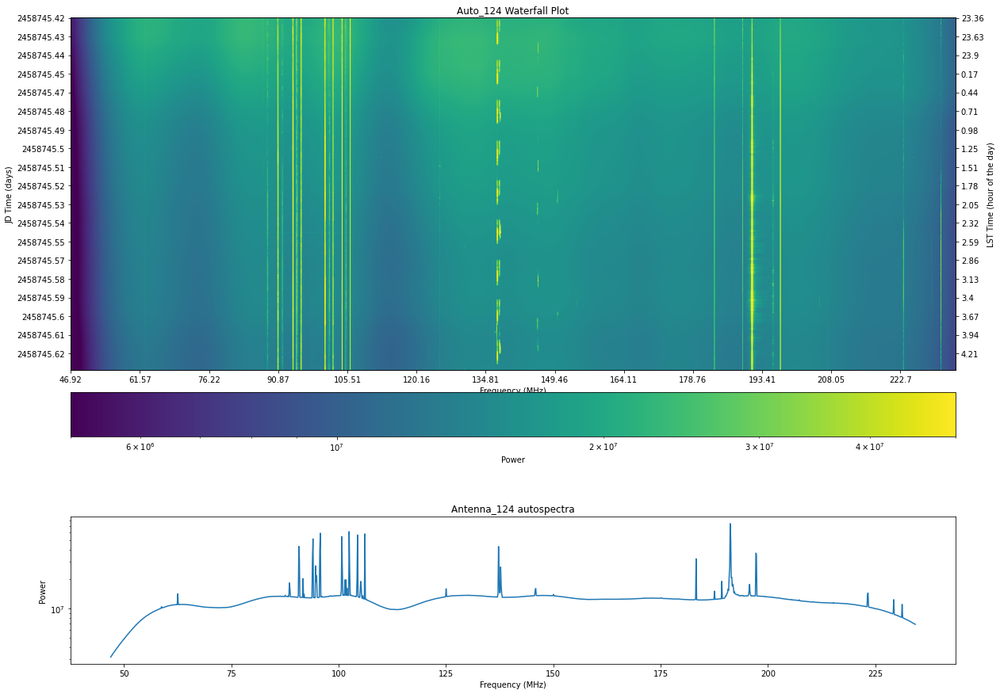

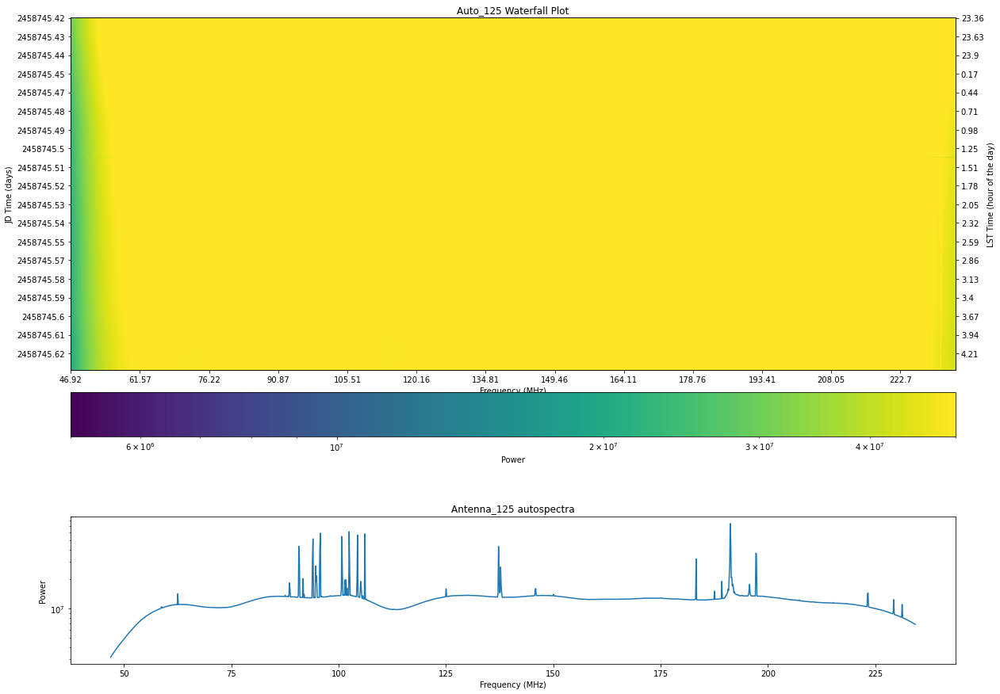

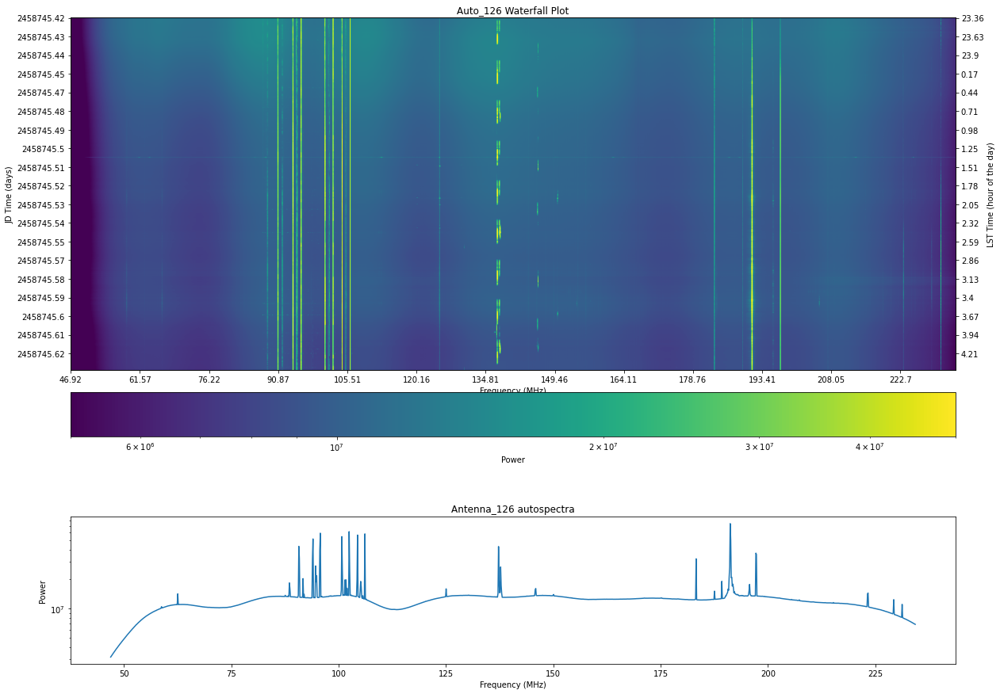

In [591]:
separate_allauto_waterfall_lineplot(0.3*10e6, 0.3*10e7)

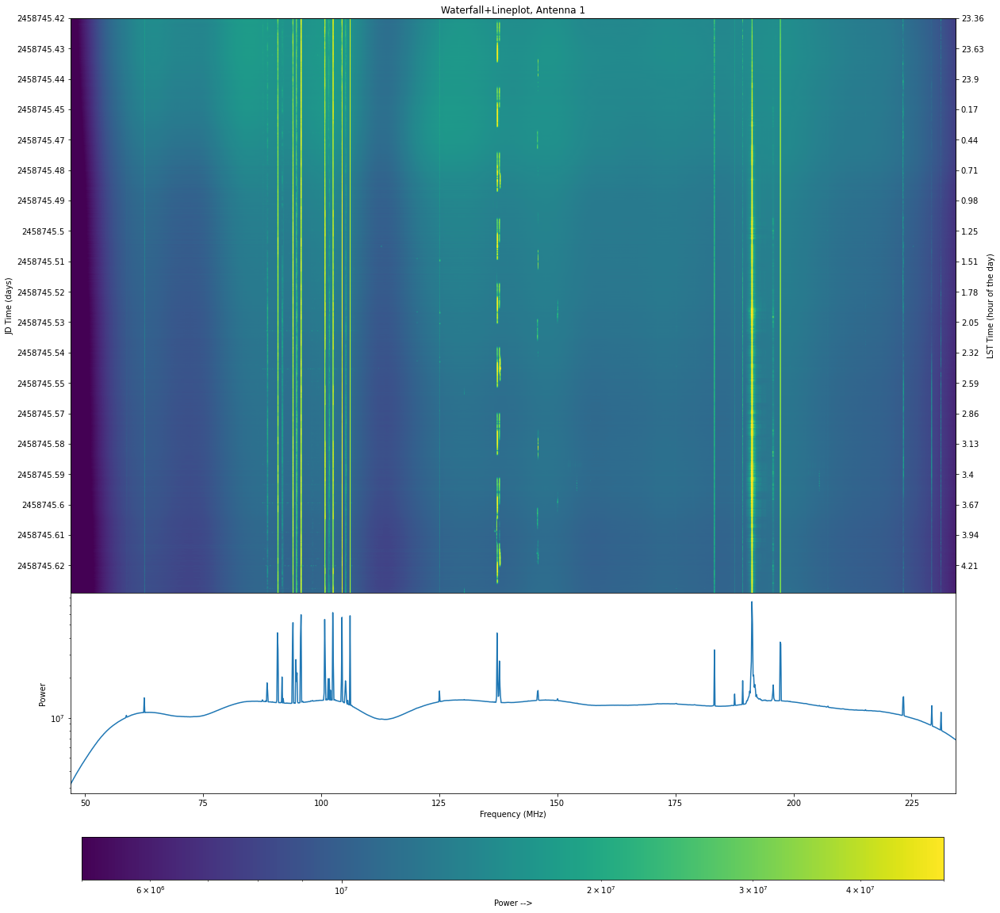

In [592]:
#waterfall and line plot on same axis

freq = uv.freq_array[0]*1e-6
fig = plt.figure(figsize=(20,20))

#can use gridspec instead of saying add_subplot(1,2,1) etc
gs = gridspec.GridSpec(2, 1, height_ratios=[2,1]) 

#creates waterfall subplot
waterfall= plt.subplot(gs[0])

#create time axis
jd_ax=plt.gca()

#there are a lot of redundancies in time_array, so to make sure that we have a list
#of unique times to work with, we start off by making a new array... not doing this will
#make things get messy. gave me a blank plot at first with a bunch of lines on the side
#before i did this.
times= np.unique(uv.time_array)

#create the plot. uv.get_data will get data from specified antennas
#colors.LogNorm() puts colors on log scale
im = plt.imshow(np.abs(uv.get_data((1,1, uv.polarization_array[0]))),norm=colors.LogNorm(), 
           vmin=.5*10e6, vmax=.5*10e7, aspect='auto')
waterfall.set_title('Waterfall+Lineplot, Antenna '+str(1))

# get an array of frequencies in MHz
freqs = uv.freq_array[0, :] / 1000000
xticks = np.arange(0, len(freqs), 120)
plt.xticks(xticks, labels =np.around(freqs[xticks],2))

jd_ax.set_ylabel('JD Time (days)')

#makes equally spaced ticks in increments of 100. since we are assuming time is pretty
#continuous, this will cover all times pretty well if we go from 0 to the length 
jd_yticks = np.arange(0,len(times),100)
#set_yticks takes a List of y-axis tick locations. its purpose is to set tick locations
jd_ax.set_yticks(jd_yticks)
#this function actually determines what the tickmarks will say.
jd_ax.set_yticklabels(np.around(times[jd_yticks],2))


#create second axis
lst_ax = jd_ax.twinx()
lst_ax.set_ylabel('LST Time (hour of the day)')

#lst_array is in radians, and we want it in *hours*.. rad*180/pi = degrees
#one hour= 15 degrees
lst_hours = (uv.lst_array*(180/np.pi))/(15)

#creates array of unique lsts
lsts= lst_hours.reshape(uv.Ntimes,uv.Nbls)
lsts = lsts[:,0]

#set the ticks of the lst axis to match the lst_array in hours
lst_yticks = np.arange(0,len(lsts),100)
lst_ax.set_yticks(lst_yticks)
lst_ax.set_yticklabels(np.around(lsts[lst_yticks],2))

#gives the lst_axis information about the jd_axis. stuff like the y-dimension of the data. 
#gets the axes to line up properly. will make it so that the tick-marks lining up, and the 
#zeroth entry of times[jd_yticks] lining up with the zeroth entry of lsts[lst_yticks]
lst_ax.set_ylim(jd_ax.get_ylim())

#makes it so that the second axis does not alter the structure of the figure
jd_ax.autoscale(False)
lst_ax.autoscale(False)

#creates line subplot and positions it according to gs[1]
line= plt.subplot(gs[1])

averaged_data= np.abs(np.average(uv.get_data((1,1, uv.polarization_array[0])),0))

plt.plot(freq,averaged_data)
line.set_yscale('log')
line.set_xlabel('Frequency (MHz)')
line.set_ylabel('Power')
#sets the range of the graph to be the same range as waterfall plot
line.set_xlim(freq[0],freq[-1])


#makes waterfall x ticks invisible
plt.setp(waterfall.get_xticklabels(), visible=False)

#brings plots together
plt.subplots_adjust(hspace=.0)


#pad moves colorbar farther from plot
cbar = plt.colorbar(im, pad= 0.15, orientation = 'horizontal')
cbar.set_label('Power -->')


In [593]:
#function for waterfall+lineplot on same axis
def allauto_waterfall_lineplot (colorbar_min, colorbar_max):
    
    for ant in uv.antenna_numbers:
        freq = uv.freq_array[0]*1e-6
        fig = plt.figure(figsize=(20,20))

        #can use gridspec instead of saying add_subplot(1,2,1) etc
        gs = gridspec.GridSpec(2, 1, height_ratios=[2,1]) 

        #creates waterfall subplot
        waterfall= plt.subplot(gs[0])

        #create time axis
        jd_ax=plt.gca()

        #there are a lot of redundancies in time_array, so to make sure that we have a list
        #of unique times to work with, we start off by making a new array... not doing this will
        #make things get messy. gave me a blank plot at first with a bunch of lines on the side
        #before i did this.
        times= np.unique(uv.time_array)

        #create the plot. uv.get_data will get data from specified antennas
        #colors.LogNorm() puts colors on log scale
        im = plt.imshow(np.abs(uv.get_data((ant,ant, uv.polarization_array[0]))),norm=colors.LogNorm(), 
                   vmin=.5*10e6, vmax=.5*10e7, aspect='auto')
        waterfall.set_title('Waterfall+Lineplot, Antenna '+str(ant))

        # get an array of frequencies in MHz
        freqs = uv.freq_array[0, :] / 1000000
        xticks = np.arange(0, len(freqs), 120)
        plt.xticks(xticks, labels =np.around(freqs[xticks],2))

        jd_ax.set_ylabel('JD Time (days)')

        #makes equally spaced ticks in increments of 100. since we are assuming time is pretty
        #continuous, this will cover all times pretty well if we go from 0 to the length 
        jd_yticks = np.arange(0,len(times),100)
        #set_yticks takes a List of y-axis tick locations. its purpose is to set tick locations
        jd_ax.set_yticks(jd_yticks)
        #this function actually determines what the tickmarks will say.
        jd_ax.set_yticklabels(np.around(times[jd_yticks],2))


        #create second axis
        lst_ax = jd_ax.twinx()
        lst_ax.set_ylabel('LST Time (hour of the day)')

        #lst_array is in radians, and we want it in *hours*.. rad*180/pi = degrees
        #one hour= 15 degrees
        lst_hours = (uv.lst_array*(180/np.pi))/(15)

        #creates array of unique lsts
        lsts= lst_hours.reshape(uv.Ntimes,uv.Nbls)
        lsts = lsts[:,0]

        #set the ticks of the lst axis to match the lst_array in hours
        lst_yticks = np.arange(0,len(lsts),100)
        lst_ax.set_yticks(lst_yticks)
        lst_ax.set_yticklabels(np.around(lsts[lst_yticks],2))

        #gives the lst_axis information about the jd_axis. stuff like the y-dimension of the data. 
        #gets the axes to line up properly. will make it so that the tick-marks lining up, and the 
        #zeroth entry of times[jd_yticks] lining up with the zeroth entry of lsts[lst_yticks]
        lst_ax.set_ylim(jd_ax.get_ylim())

        #makes it so that the second axis does not alter the structure of the figure
        jd_ax.autoscale(False)
        lst_ax.autoscale(False)

        #creates line subplot and positions it according to gs[1]
        line= plt.subplot(gs[1])

        averaged_data= np.abs(np.average(uv.get_data((1,1, uv.polarization_array[0])),0))

        plt.plot(freq,averaged_data)
        line.set_yscale('log')
        line.set_xlabel('Frequency (MHz)')
        line.set_ylabel('Power')
        #sets the range of the graph to be the same range as waterfall plot
        line.set_xlim(freq[0],freq[-1])


        #makes waterfall x ticks invisible
        plt.setp(waterfall.get_xticklabels(), visible=False)

        #brings plots together
        plt.subplots_adjust(hspace=.0)


        #pad moves colorbar farther from plot
        cbar = plt.colorbar(im, pad= 0.15, orientation = 'horizontal')
        cbar.set_label('Power -->')
        
        plt.savefig('/lustre/aoc/projects/hera/amyers/gitrepos/monsterDetection/waterfalls/'+
                    'WF_LP_ant'+str(ant))
        plt.show()
        plt.close()
    return;

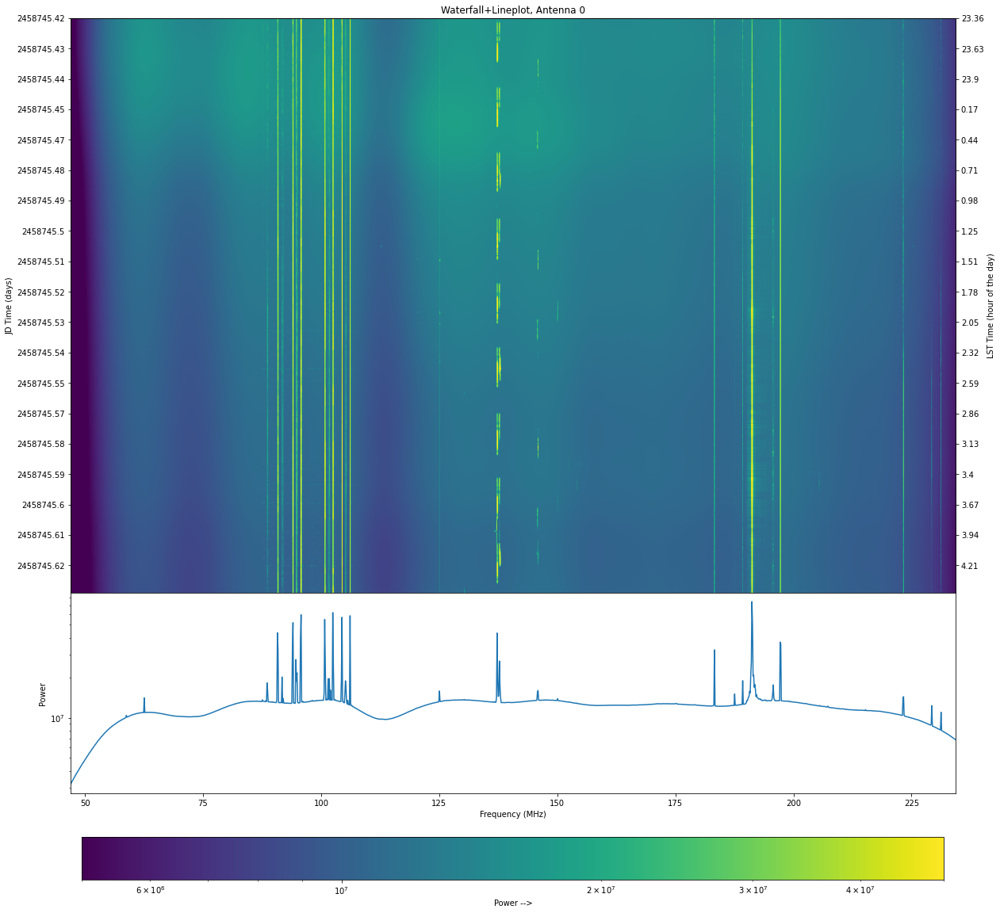

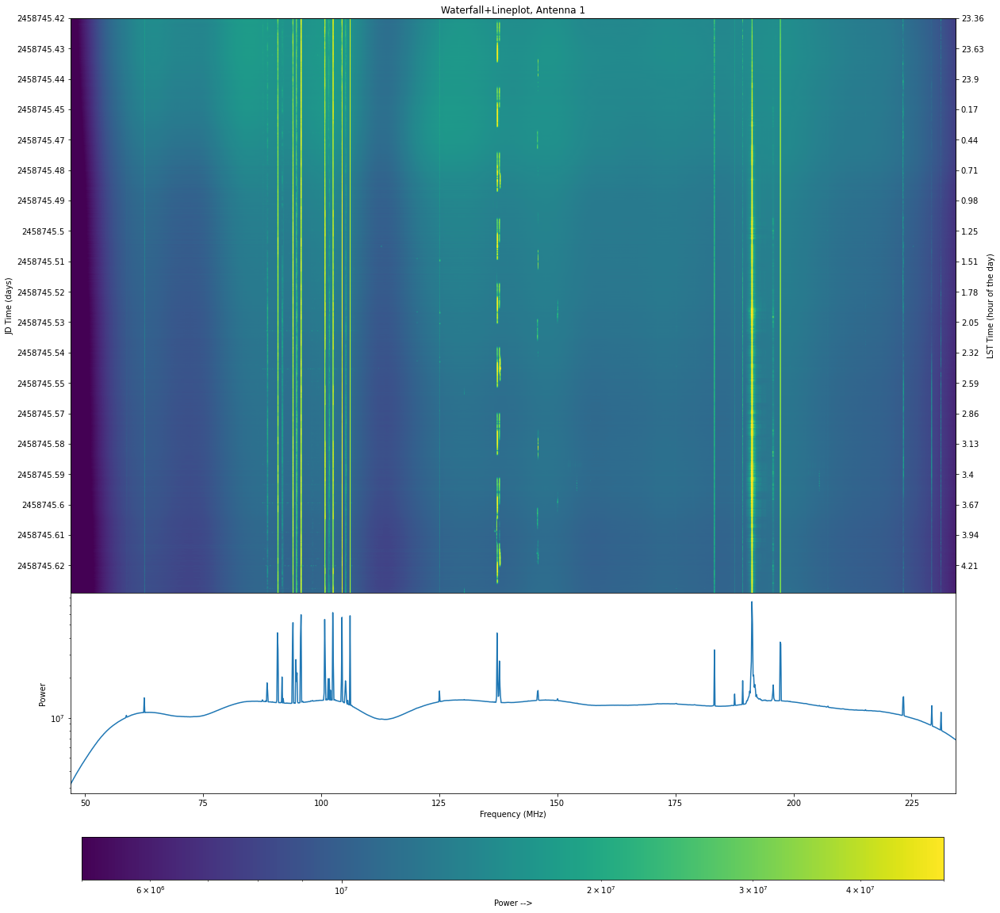

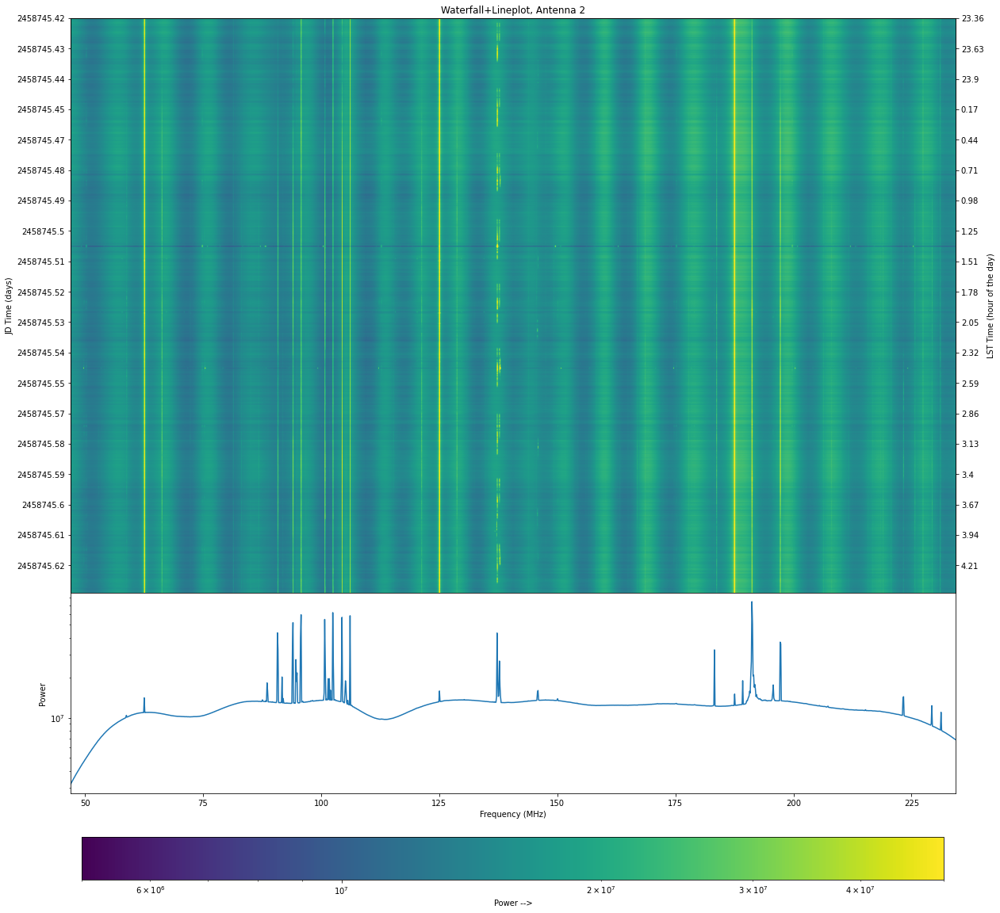

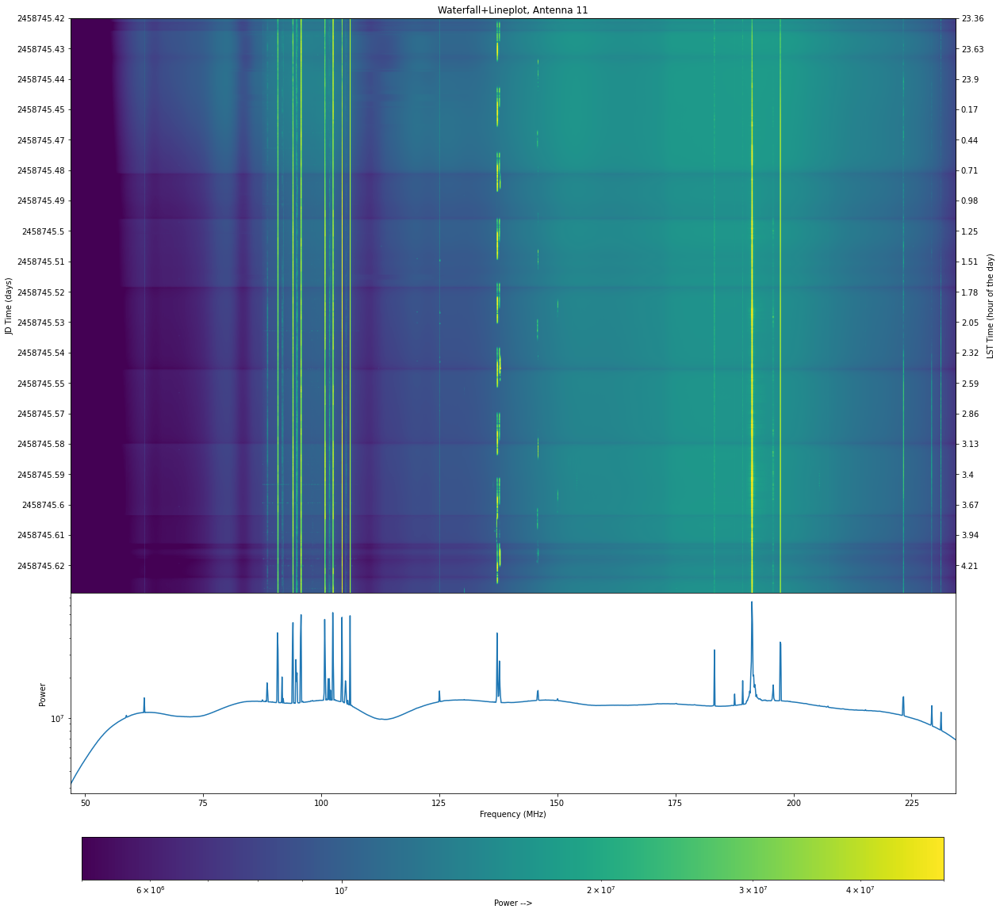

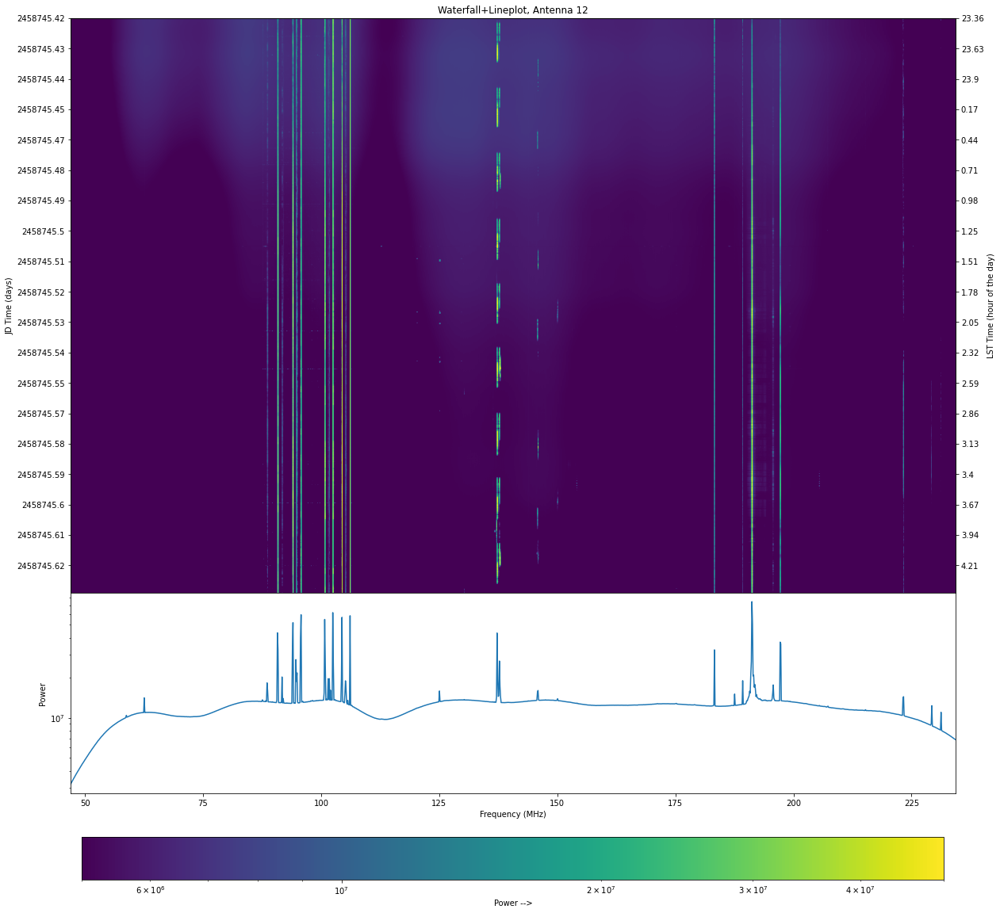

...

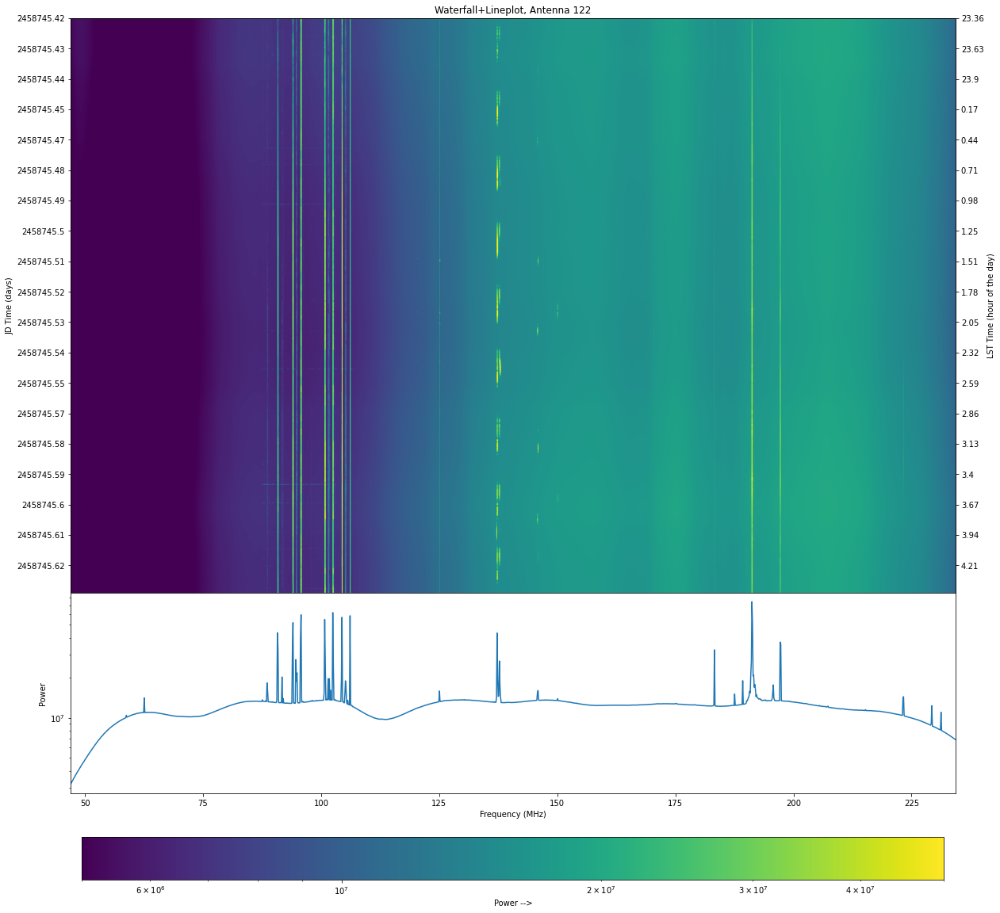

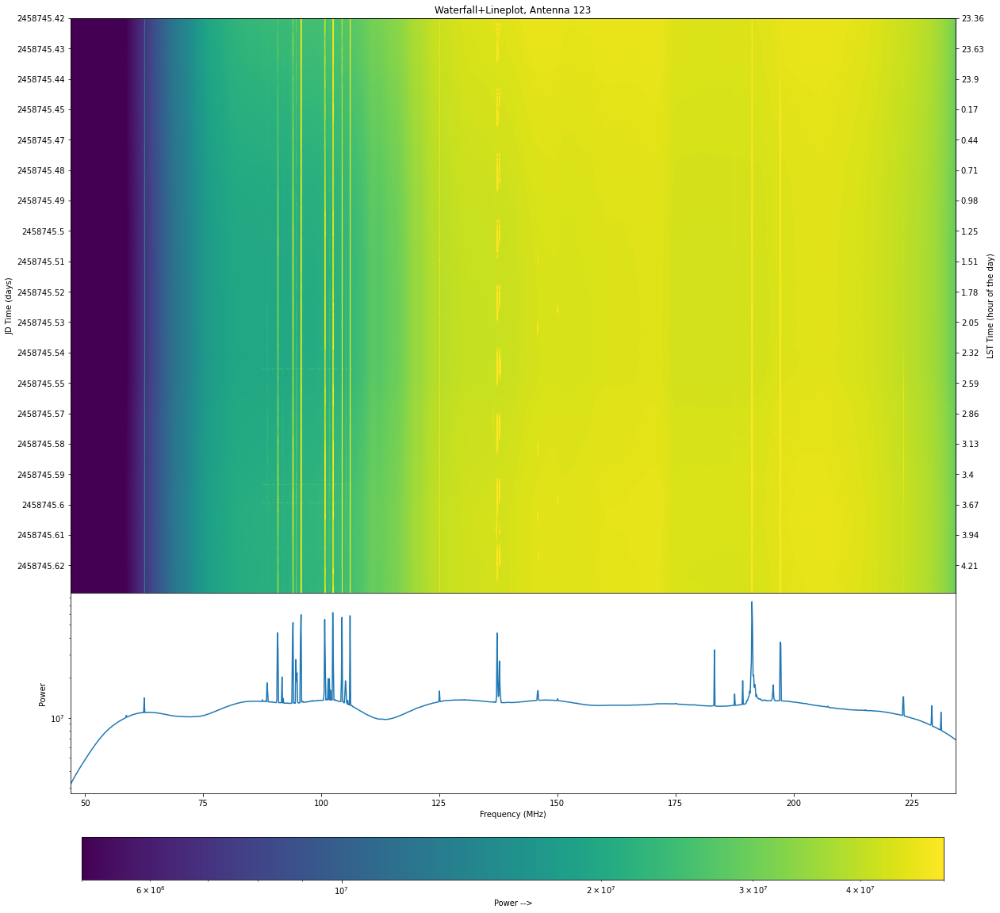

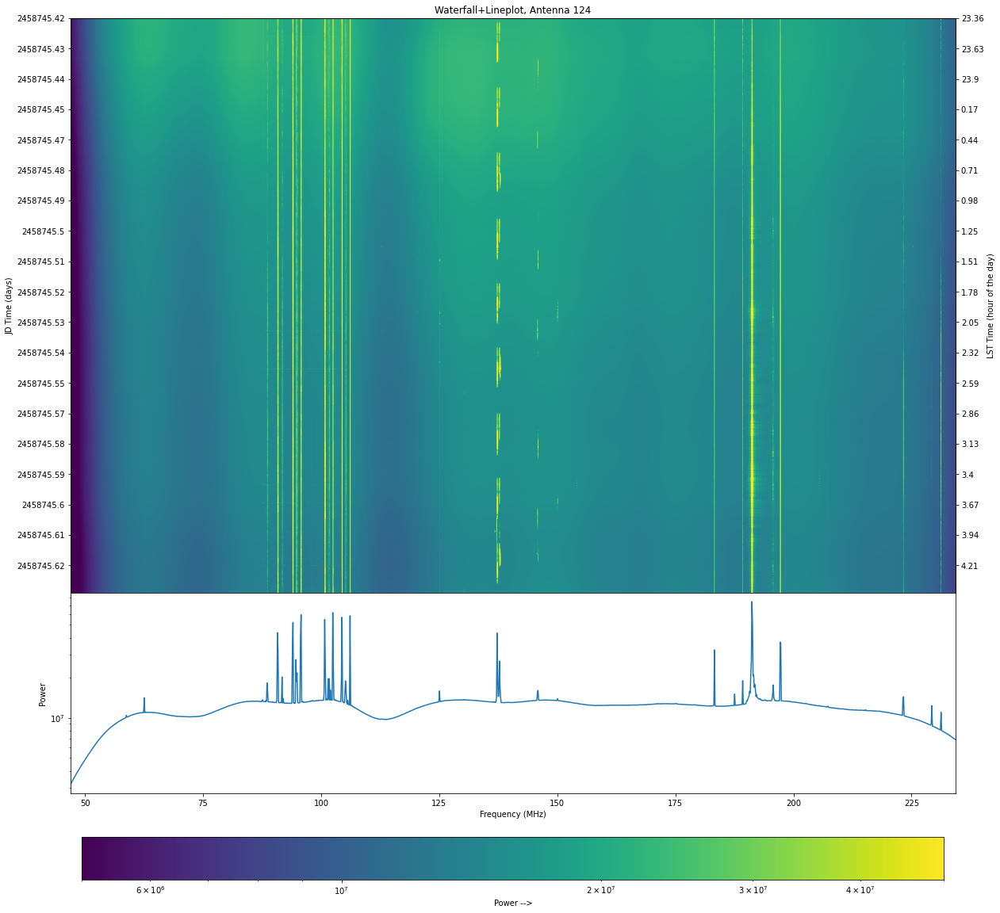

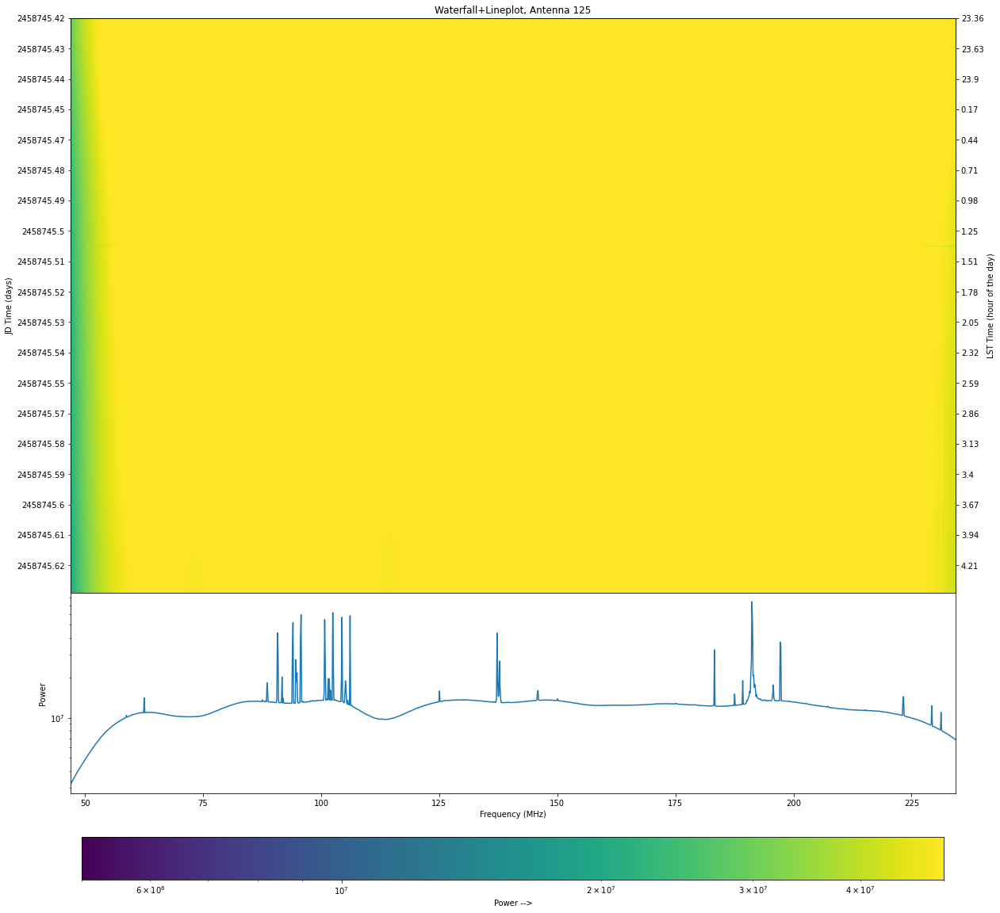

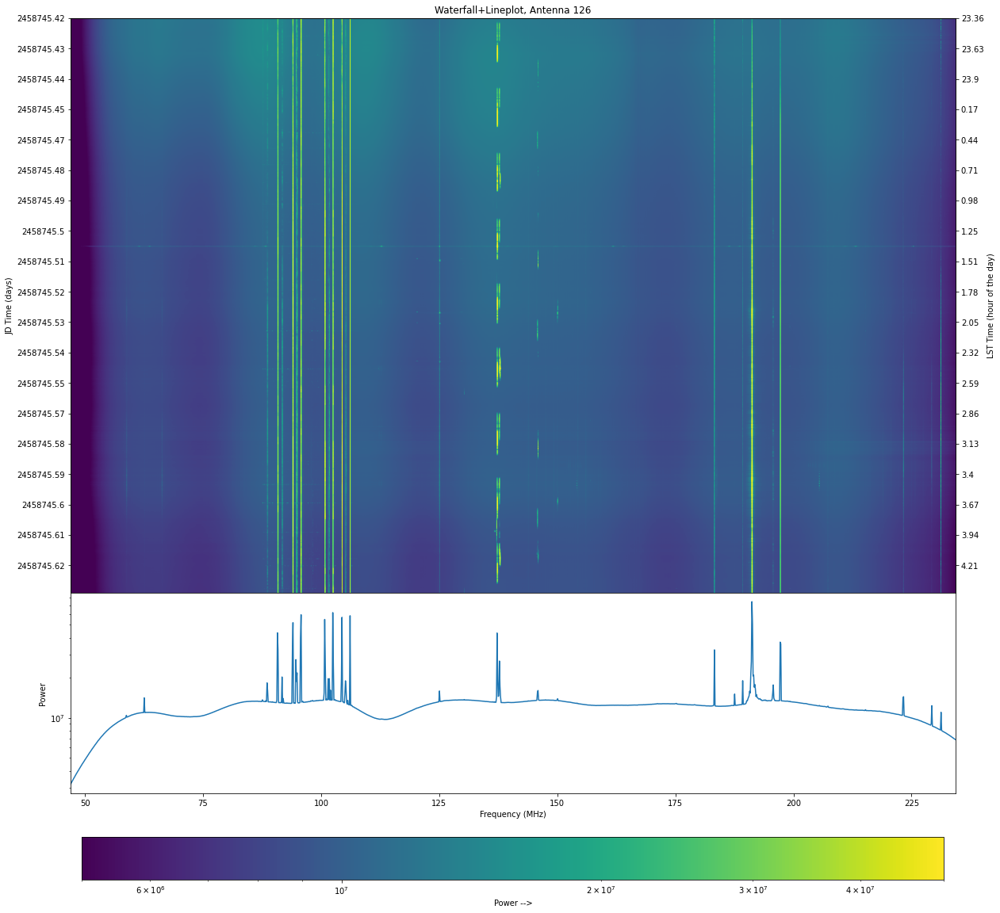

In [594]:
allauto_waterfall_lineplot(0.3*10e6, 0.3*10e7)

In [595]:
def auto_waterfall_lineplot (ant,colorbar_min, colorbar_max):
    
    freq = uv.freq_array[0]*1e-6
    fig = plt.figure(figsize=(20,20))

    #can use gridspec instead of saying add_subplot(1,2,1) etc
    gs = gridspec.GridSpec(2, 1, height_ratios=[2,1]) 

    #creates waterfall subplot
    waterfall= plt.subplot(gs[0])
        
    #create time axis
    jd_ax=plt.gca()

    #there are a lot of redundancies in time_array, so to make sure that we have a list
    #of unique times to work with, we start off by making a new array... not doing this will
    #make things get messy. gave me a blank plot at first with a bunch of lines on the side
    #before i did this.
    times= np.unique(uv.time_array)

    #create the plot. uv.get_data will get data from specified antennas
    #colors.LogNorm() puts colors on log scale
    im = plt.imshow(np.abs(uv.get_data((ant,ant, uv.polarization_array[0]))),norm=colors.LogNorm(), 
                vmin=.5*10e6, vmax=.5*10e7, aspect='auto')
    waterfall.set_title('Waterfall+Lineplot, Antenna '+str(ant))

    # get an array of frequencies in MHz
    freqs = uv.freq_array[0, :] / 1000000
    xticks = np.arange(0, len(freqs), 120)
    plt.xticks(xticks, labels =np.around(freqs[xticks],2))

    jd_ax.set_ylabel('JD Time (days)')

    #makes equally spaced ticks in increments of 100. since we are assuming time is pretty
    #continuous, this will cover all times pretty well if we go from 0 to the length 
    jd_yticks = np.arange(0,len(times),100)
    #set_yticks takes a List of y-axis tick locations. its purpose is to set tick locations
    jd_ax.set_yticks(jd_yticks)
    #this function actually determines what the tickmarks will say.
    jd_ax.set_yticklabels(np.around(times[jd_yticks],2))


    #create second axis
    lst_ax = jd_ax.twinx()
    lst_ax.set_ylabel('LST Time (hour of the day)')

    #lst_array is in radians, and we want it in *hours*.. rad*180/pi = degrees
    #one hour= 15 degrees
    lst_hours = (uv.lst_array*(180/np.pi))/(15)

    #creates array of unique lsts
    lsts= lst_hours.reshape(uv.Ntimes,uv.Nbls)
    lsts = lsts[:,0]

    #set the ticks of the lst axis to match the lst_array in hours
    lst_yticks = np.arange(0,len(lsts),100)
    lst_ax.set_yticks(lst_yticks)
    lst_ax.set_yticklabels(np.around(lsts[lst_yticks],2))

    #gives the lst_axis information about the jd_axis. stuff like the y-dimension of the data. 
    #gets the axes to line up properly. will make it so that the tick-marks lining up, and the 
    #zeroth entry of times[jd_yticks] lining up with the zeroth entry of lsts[lst_yticks]
    lst_ax.set_ylim(jd_ax.get_ylim())

    #makes it so that the second axis does not alter the structure of the figure
    jd_ax.autoscale(False)
    lst_ax.autoscale(False)

    #creates line subplot and positions it according to gs[1]
    line= plt.subplot(gs[1])

    averaged_data= np.abs(np.average(uv.get_data((1,1, uv.polarization_array[0])),0))

    plt.plot(freq,averaged_data)
    line.set_yscale('log')
    line.set_xlabel('Frequency (MHz)')
    line.set_ylabel('Power')
    #sets the range of the graph to be the same range as waterfall plot
    line.set_xlim(freq[0],freq[-1])


    #makes waterfall x ticks invisible
    plt.setp(waterfall.get_xticklabels(), visible=False)

    #brings plots together
    plt.subplots_adjust(hspace=.0)


    #pad moves colorbar farther from plot
    cbar = plt.colorbar(im, pad= 0.15, orientation = 'horizontal')
    cbar.set_label('Power -->')
        
    plt.savefig('/lustre/aoc/projects/hera/amyers/gitrepos/monsterDetection/waterfalls/'+
                    'WF_LP_ant'+str(ant))
    plt.show()
    plt.close()


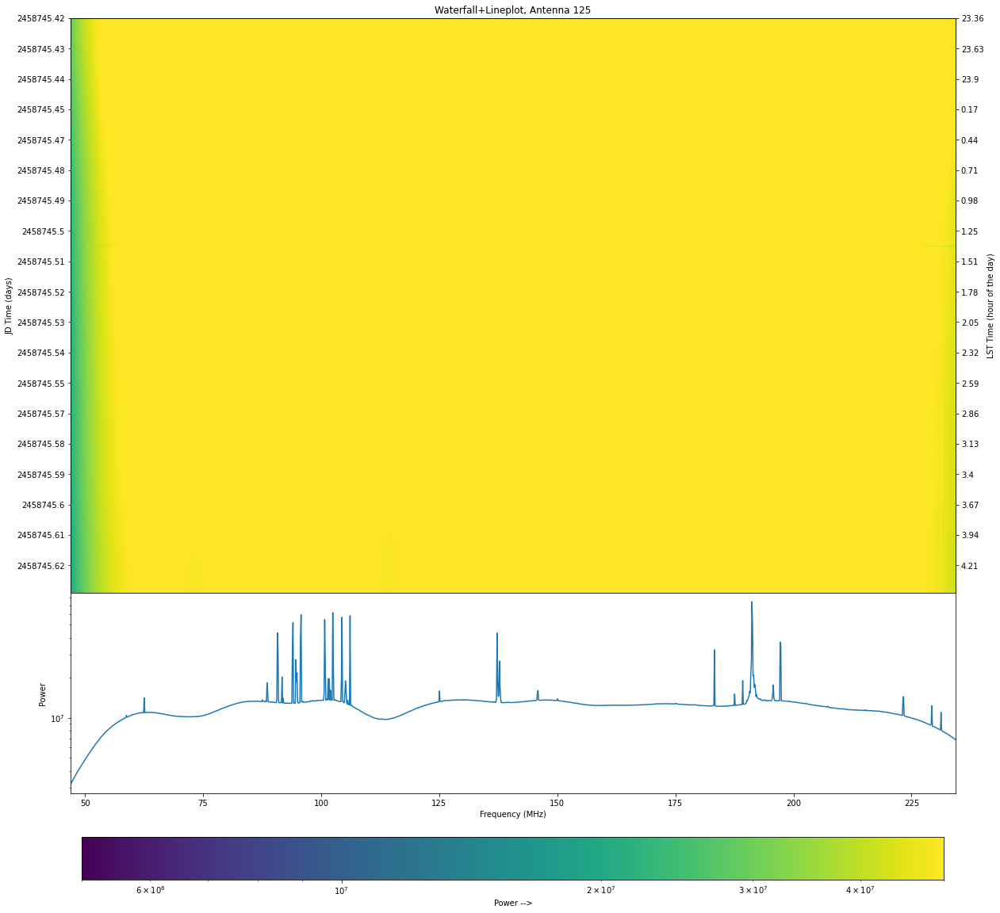

In [596]:
auto_waterfall_lineplot(125,0.3*10e6, 0.3*10e7)